In [47]:
! pip install pandas networkx folium contextily plotly pyproj geopandas scikit-learn  matplotlib folium numpy

In [157]:
import numpy as np
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
import matplotlib as mpl
import folium
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
import seaborn as sns
import plotly.graph_objs as go
import matplotlib.animation as animation
import matplotlib.patches as mpatches
import geopandas as gpd
import contextily as ctx
from pyproj import Transformer


# Degree of Centrality And K-means Clustring

In [214]:

class DegreeOfCentrality:
    def __init__(self, data_folder):
        self.data_folder = data_folder
        self.stops_df = None
        self.stop_times_df = None
        self.graph = None  

        self.degree_centrality = None
        self.weighted_degree_centrality = None
        self.map_shapefile = None
        self.cluster_labels = None
        self.kmeans_model = None

    def load_data(self):
        
        self.stops_df = pd.read_csv(f'{self.data_folder}/stops.txt')
        self.stop_times_df = pd.read_csv(f'{self.data_folder}/stop_times.txt')

    def build_graph(self, directed=False, weighted=False):

        if directed:
            self.graph = nx.DiGraph()
        else:
            self.graph = nx.Graph()

        for idx, row in self.stops_df.iterrows():
            stop_id = row['stop_id']
            self.graph.add_node(stop_id,
                                stop_name=row['stop_name'],
                                stop_lat=row['stop_lat'],
                                stop_lon=row['stop_lon'])

        grouped = self.stop_times_df.groupby('trip_id')
        for trip_id, group in grouped:
            group = group.sort_values('stop_sequence')
            stop_ids = group['stop_id'].tolist()

            for i in range(len(stop_ids) - 1):
                u = stop_ids[i]
                v = stop_ids[i + 1]
                if weighted:
                    if self.graph.has_edge(u, v):
                        self.graph[u][v]['weight'] += 1
                    else:
                        self.graph.add_edge(u, v, weight=1)
                else:
                    self.graph.add_edge(u, v)

    def compute_degree_centrality(self):

        self.degree_centrality = nx.degree_centrality(self.graph)

    def compute_weighted_degree_centrality(self):

        weighted_degrees = dict(self.graph.degree(weight='weight'))
        max_degree = max(weighted_degrees.values())

        self.weighted_degree_centrality = {node: degree / max_degree for node, degree in weighted_degrees.items()}

    def compute_all_centrality_measures(self):

        self.compute_degree_centrality()
        self.compute_weighted_degree_centrality()


    def visualize_network(self, centrality_measure='degree', shapefile_path="./Betweeness_modularity_data/Brussels_map/UrbAdm_REGION.shp",frame_code_x="EPSG:3857",frame_code_y="EPSG:4326"):
        
        #the higher centrality values correspond to darker shades.

        centrality = self._get_centrality_measure(centrality_measure)

        data = []
        for node, attrs in self.graph.nodes(data=True):
            if 'stop_lat' in attrs and 'stop_lon' in attrs:
                cval = centrality.get(node, 0)
                data.append({
                    'stop_id': node,
                    'stop_name': attrs['stop_name'],
                    'stop_lon': attrs['stop_lon'],
                    'stop_lat': attrs['stop_lat'],
                    'centrality': cval
                })
        stops_with_centrality = pd.DataFrame(data)

        if stops_with_centrality.empty:
            print("No node data available for plotting.")
            return

        gdf = gpd.read_file(shapefile_path).to_crs(frame_code_x)

        transformer = Transformer.from_crs(frame_code_y, "EPSG:3857", always_xy=True)
        x, y = transformer.transform(stops_with_centrality["stop_lon"].values, stops_with_centrality["stop_lat"].values)
        stops_with_centrality["stop_lon"] = x
        stops_with_centrality["stop_lat"] = y

        stops_with_centrality = stops_with_centrality.dropna(subset=["stop_lon", "stop_lat", "centrality"])

        plt.figure(figsize=(10, 8))

        scatter = plt.scatter(
            stops_with_centrality["stop_lon"],
            stops_with_centrality["stop_lat"],
            c=stops_with_centrality["centrality"],
            s=50 + 5000 * stops_with_centrality["centrality"],  
            cmap="inferno_r",  
            alpha=0.7,
            edgecolor="k",
        )

        gdf.boundary.plot(ax=plt.gca(), color="black")

        cbar = plt.colorbar(scatter, label=f"{centrality_measure.capitalize()} Centrality")
        plt.xlabel("Longitude")
        plt.ylabel("Latitude")
        plt.title(f"{centrality_measure.capitalize()} Centrality Map")

        ctx.add_basemap(plt.gca(), crs="EPSG:3857", source=ctx.providers.OpenStreetMap.Mapnik)

        plt.tight_layout()
        plt.show()


    def get_top_n_stops_by_centrality(self, centrality_type='degree', n=5):

        centrality = self._get_centrality_measure(centrality_type)

        sorted_nodes = sorted(centrality.items(), key=lambda x: x[1], reverse=True)
        top_stops = []
        for stop_id, centrality_value in sorted_nodes[:n]:
            stop_name = self.graph.nodes[stop_id]['stop_name']
            top_stops.append((stop_id, stop_name, centrality_value))
        return top_stops

    def plot_degree_centrality_histogram(self, centrality_type='degree', bins=20):

        centrality = self._get_centrality_measure(centrality_type)

        plt.figure(figsize=(10, 6))
        sns.histplot(list(centrality.values()), bins=bins, kde=True)
        plt.title(f'{centrality_type.capitalize()} Centrality Distribution')
        plt.xlabel('Centrality')
        plt.ylabel('Frequency')
        plt.show()

    def plot_centrality_scatter(self, centrality_x='degree', centrality_y='betweenness'):

        centrality_x_values = self._get_centrality_measure(centrality_x)
        centrality_y_values = self._get_centrality_measure(centrality_y)

        x_values = []
        y_values = []
        for node in self.graph.nodes():
            x_values.append(centrality_x_values.get(node, 0))
            y_values.append(centrality_y_values.get(node, 0))

        plt.figure(figsize=(10, 6))
        sns.scatterplot(x=x_values, y=y_values)
        plt.title(f'{centrality_x.capitalize()} vs {centrality_y.capitalize()} Centrality')
        plt.xlabel(f'{centrality_x.capitalize()} Centrality')
        plt.ylabel(f'{centrality_y.capitalize()} Centrality')
        plt.show()

    def plot_degree_distribution(self):

        degrees = [degree for node, degree in self.graph.degree()]
        degree_counts = pd.Series(degrees).value_counts().sort_index()

        plt.figure(figsize=(10, 6))
        sns.barplot(x=degree_counts.index, y=degree_counts.values)
        plt.title('Degree Distribution')
        plt.xlabel('Degree')
        plt.ylabel('Number of Nodes')
        plt.show()
        
    def visualize_network_top_nodes(self, centrality_type='degree', top_n=5, figsize=(12, 12)):

        centrality = self._get_centrality_measure(centrality_type)
        
        centrality_df = pd.DataFrame({
            'Node': list(centrality.keys()),
            'Centrality': list(centrality.values())
        }).sort_values('Centrality', ascending=False)
        
        top_nodes = centrality_df['Node'][:top_n]
        
        pos = {node: (data['stop_lon'], data['stop_lat']) for node, data in self.graph.nodes(data=True)}
        
        node_sizes = [centrality[node] * 1000 for node in self.graph.nodes()]
        node_colors = list(centrality.values())
        
        plt.figure(figsize=figsize)
        nx.draw(
            self.graph,
            pos,
            node_size=node_sizes,
            node_color=node_colors,
            cmap=plt.cm.Blues,
            with_labels=False,
            alpha=0.8
        )
        
        labels = {node: f"{node}" for node in top_nodes}
        nx.draw_networkx_labels(self.graph, pos, labels=labels, font_size=10, font_color='red')
        
        plt.title(f"{centrality_type.capitalize()} Centrality with Top Nodes Highlighted")
        plt.show()

    def perform_kmeans_clustering(self, n_clusters=3, features=['degree', 'betweenness', 'closeness']):

        self.compute_all_centrality_measures()

        data = {'Node': list(self.graph.nodes())}
        if 'degree' in features:
            data['Degree'] = [self.degree_centrality[node] for node in self.graph.nodes()]
        if 'weighted_degree' in features:
            data['Weighted_Degree'] = [self.weighted_degree_centrality[node] for node in self.graph.nodes()]

        features_df = pd.DataFrame(data)
        features_df.set_index('Node', inplace=True)

        scaler = StandardScaler()
        X_scaled = scaler.fit_transform(features_df)

        kmeans = KMeans(n_clusters=n_clusters, random_state=42)
        self.cluster_labels = kmeans.fit_predict(X_scaled)
        self.kmeans_model = kmeans

        for idx, node in enumerate(features_df.index):
            self.graph.nodes[node]['cluster'] = self.cluster_labels[idx]

        print(f"K-Means clustering completed with {n_clusters} clusters.")

    def visualize_clusters(self, figsize=(12, 12)):
        # visualize the clusters on a geographic map using a GeoDataFrame approach.
        # each cluster is represented by a unique color. A basemap is added for context.
        if self.cluster_labels is None:
            print("Please perform clustering before visualization.")
            return

        data = []
        for node, attrs in self.graph.nodes(data=True):
            if 'cluster' in attrs and 'stop_lon' in attrs and 'stop_lat' in attrs:
                data.append({
                    'stop_id': node,
                    'cluster': attrs['cluster'],
                    'stop_lon': attrs['stop_lon'],
                    'stop_lat': attrs['stop_lat']
                })

        if not data:
            print("No node data available for plotting.")
            return

        stops_df = pd.DataFrame(data)

        stops_gdf = gpd.GeoDataFrame(
            stops_df,
            geometry=gpd.points_from_xy(stops_df.stop_lon, stops_df.stop_lat),
            crs="EPSG:4326"
        )

        stops_gdf = stops_gdf.to_crs("EPSG:3857")

        fig, ax = plt.subplots(figsize=figsize)

        unique_clusters = sorted(stops_gdf["cluster"].unique())
        n_clusters = len(unique_clusters)
        cmap = plt.cm.get_cmap('Set1', n_clusters)
        colors = [cmap(i) for i in range(n_clusters)]

        if self.map_shapefile:
            gdf_area = gpd.read_file(self.map_shapefile).to_crs("EPSG:3857")
            gdf_area.boundary.plot(ax=ax, color="black", linewidth=0.5)

        for i, c in enumerate(unique_clusters):
            cluster_data = stops_gdf[stops_gdf['cluster'] == c]
            cluster_data.plot(
                ax=ax,
                color=colors[i],
                markersize=50,
                alpha=0.7,
                label=f"Cluster {c}"
            )

        ctx.add_basemap(ax, crs="EPSG:3857", source=ctx.providers.OpenStreetMap.Mapnik)

        ax.legend(title='Clusters', loc='best')
        ax.set_title("Clusters Visualization on Map")
        ax.set_xlabel("Longitude")
        ax.set_ylabel("Latitude")
        plt.tight_layout()
        plt.show()

    def plot_three_graphs_in_one_figure(self, centrality_measure='degree', shapefile_path=None, bins=20):
        fig, axes = plt.subplots(1, 3, figsize=(18, 6))

        self.visualize_network(centrality_measure=centrality_measure, shapefile_path=shapefile_path, ax=axes[0])
        axes[0].set_title(f"{centrality_measure.capitalize()} Centrality Map")

        self.plot_degree_centrality_histogram(centrality_type=centrality_measure, bins=bins, ax=axes[1])
        axes[1].set_title(f"{centrality_measure.capitalize()} Centrality Distribution")

        self.visualize_clusters(ax=axes[2])
        axes[2].set_title("Clusters Visualization")

        plt.tight_layout()
        plt.show()


    def _get_centrality_measure(self, centrality_type):
   
        if centrality_type == 'degree':
            if self.degree_centrality is None:
                self.compute_degree_centrality()
            return self.degree_centrality
        elif centrality_type == 'weighted_degree':
            if self.weighted_degree_centrality is None:
                self.compute_weighted_degree_centrality()
            return self.weighted_degree_centrality
        else:
            raise ValueError("Unsupported centrality type.")



Top 5 Stops by Degree Centrality:
Stop ID: 1063, Stop Name: CESAR DE PAEPE, Degree Centrality: 0.0029
Stop ID: 6433, Stop Name: TRONE, Degree Centrality: 0.0029
Stop ID: 6464, Stop Name: MAELBEEK, Degree Centrality: 0.0029
Stop ID: 1085, Stop Name: BERVOETS, Degree Centrality: 0.0025
Stop ID: 2301, Stop Name: ARENBERG, Degree Centrality: 0.0025

Top 5 Stops by Weighted_degree Centrality:
Stop ID: 2726F, Stop Name: LIEDTS, Weighted_degree Centrality: 1.0000
Stop ID: 2720F, Stop Name: LIEDTS, Weighted_degree Centrality: 0.9983
Stop ID: 6465, Stop Name: MAELBEEK, Weighted_degree Centrality: 0.8714
Stop ID: 6432, Stop Name: TRONE, Weighted_degree Centrality: 0.8646
Stop ID: 6433, Stop Name: TRONE, Weighted_degree Centrality: 0.8621


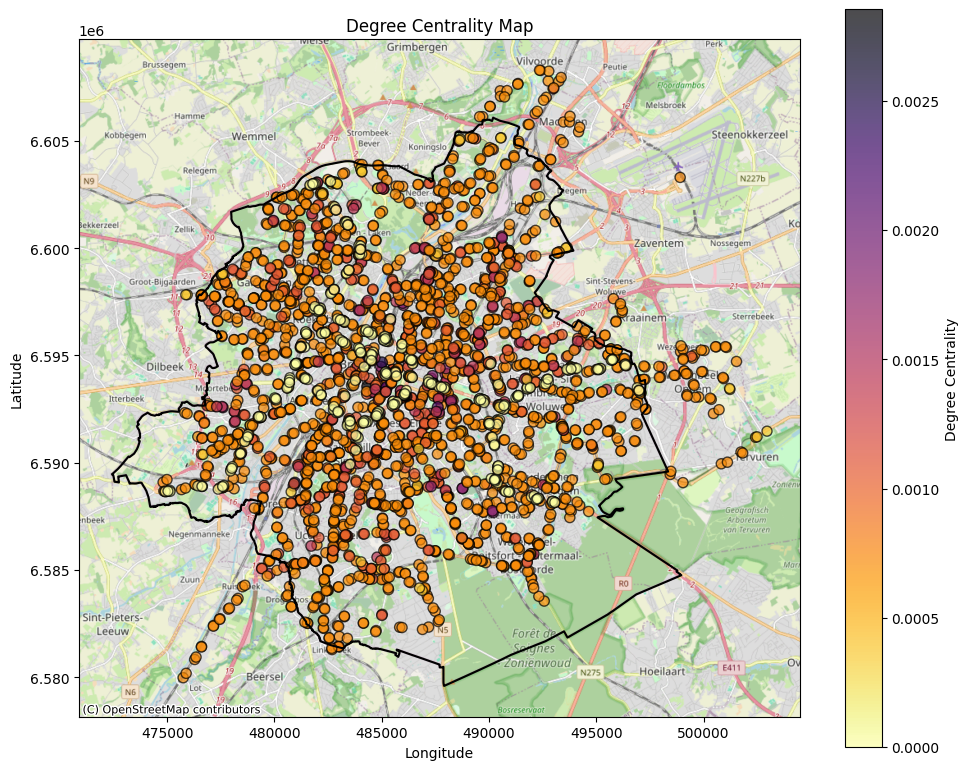

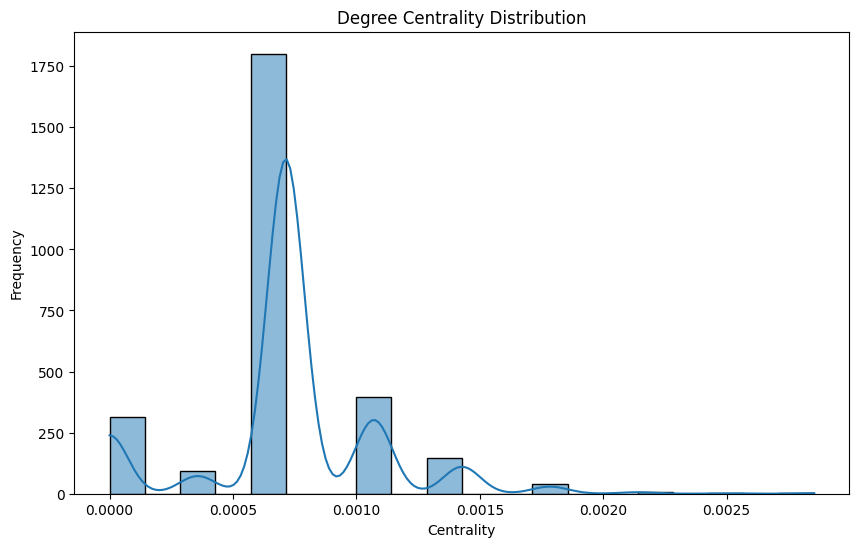

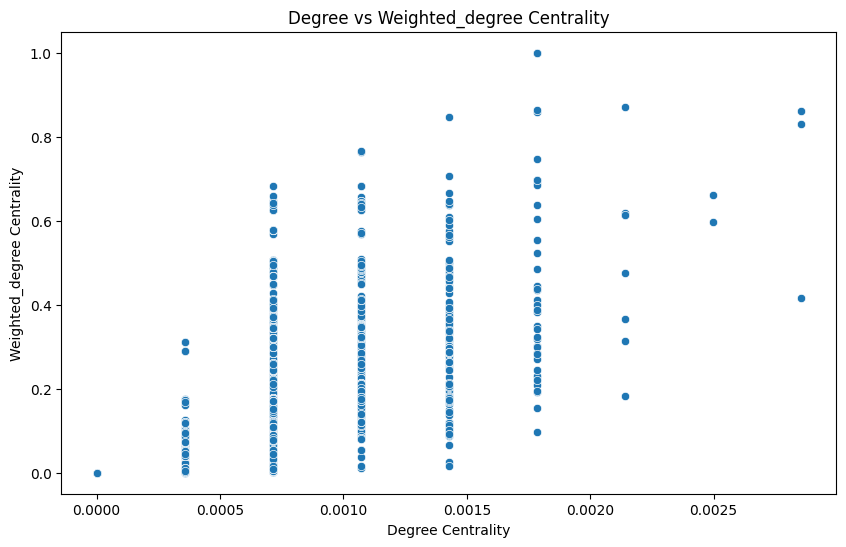

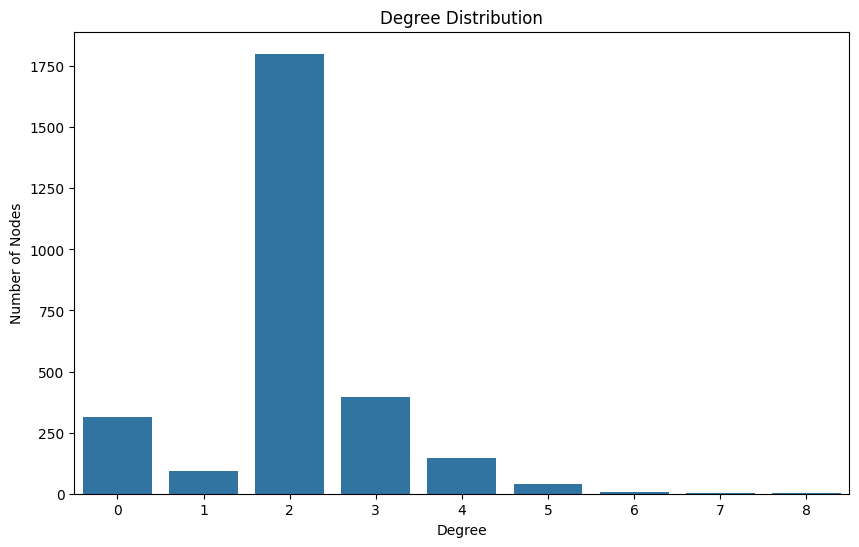

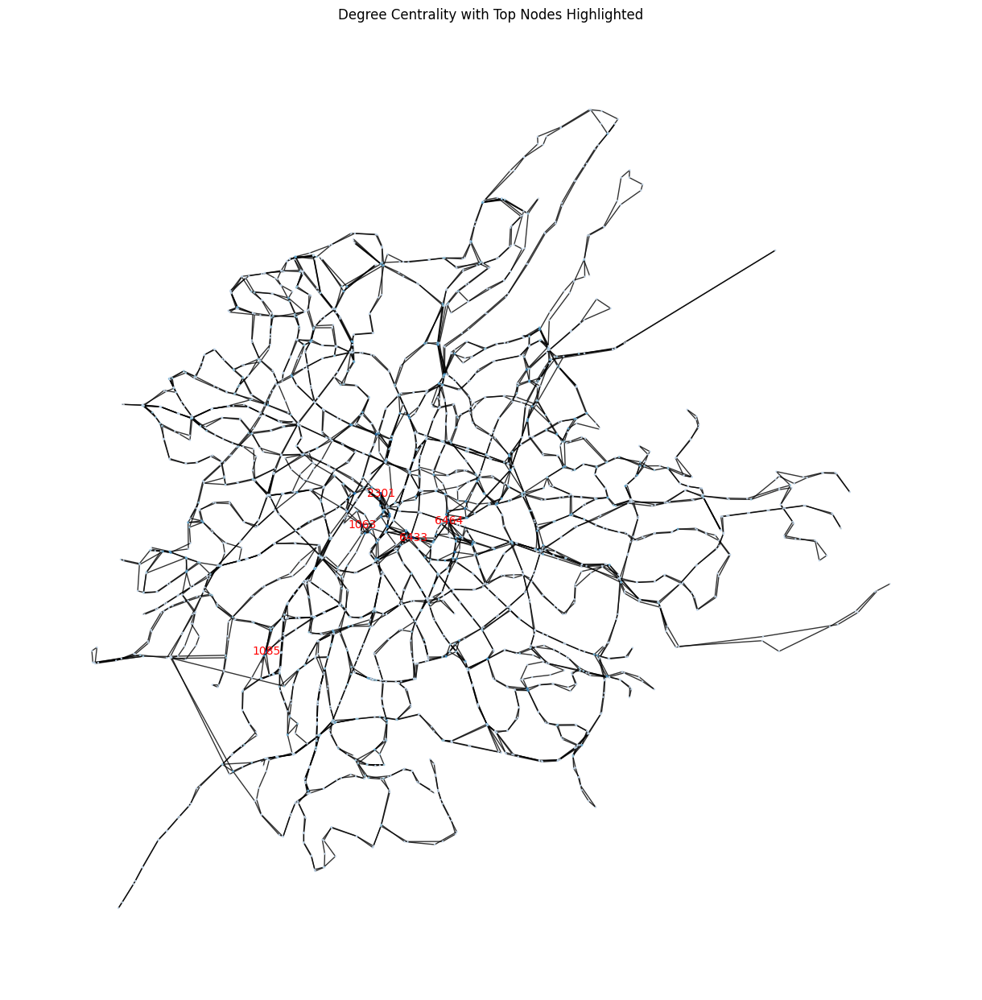


Network map saved as 'brussels_transit_network.html'
K-Means clustering completed with 5 clusters.


C:\Users\moham\AppData\Local\Temp\ipykernel_37044\3263476046.py:268: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.



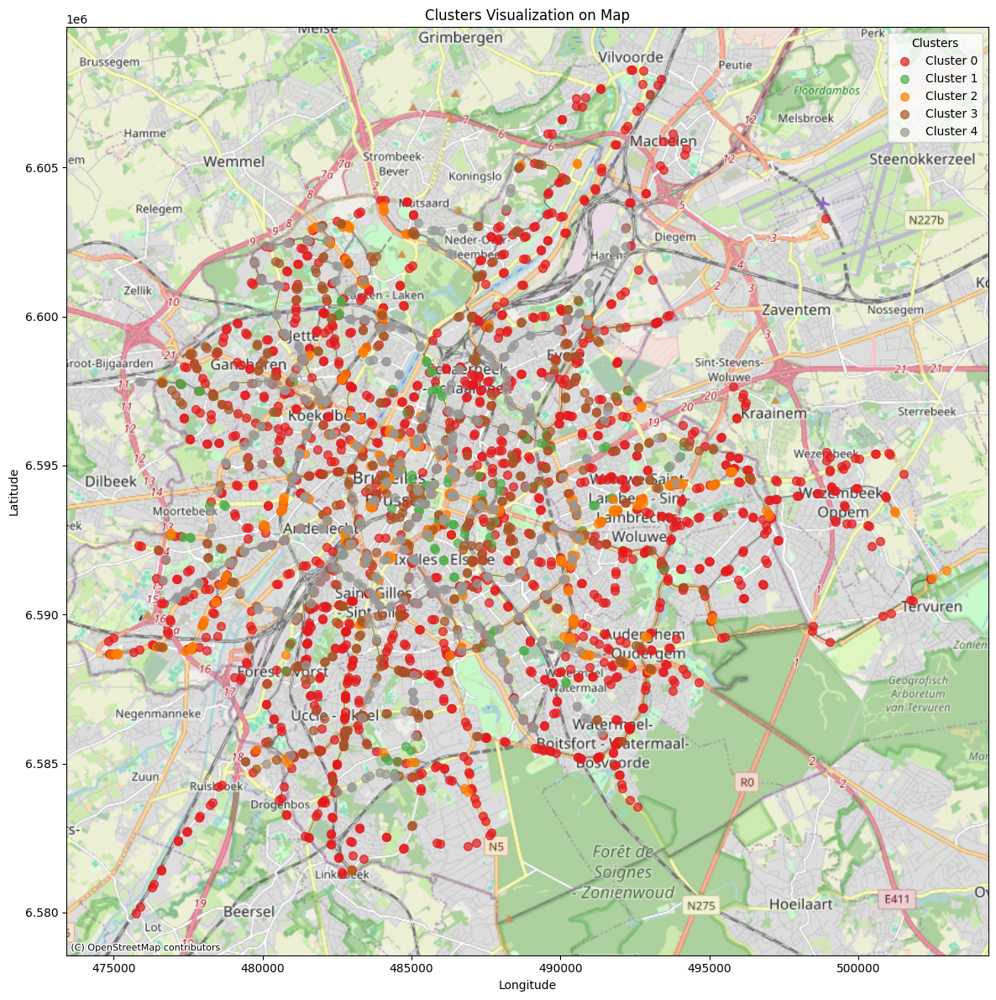

In [215]:
if __name__ == "__main__":

    DOfC = DegreeOfCentrality('./data/brussels')
    DOfC.load_data()
    DOfC.build_graph(directed=False, weighted=True)
    DOfC.compute_all_centrality_measures()

    measures = ['degree', 'weighted_degree']
    for measure in measures:
        top_stops = DOfC.get_top_n_stops_by_centrality(centrality_type=measure, n=5)
        print(f"\nTop 5 Stops by {measure.capitalize()} Centrality:")
        for stop_id, stop_name, centrality in top_stops:
            print(f"Stop ID: {stop_id}, Stop Name: {stop_name}, {measure.capitalize()} Centrality: {centrality:.4f}")

    #  latitude_of_the_map = 50.8503,longitude_of_the_map = 4.3517
    network_map = DOfC.visualize_network(centrality_measure='degree')
    # network_map.save('brussels_transit_network.html')
    network_map
    DOfC.plot_degree_centrality_histogram(centrality_type='degree', bins=20)
    DOfC.plot_centrality_scatter(centrality_x='degree', centrality_y='weighted_degree')
    DOfC.plot_degree_distribution()
    DOfC.visualize_network_top_nodes(centrality_type='degree', top_n=5, figsize=(12, 12))
    print("\nNetwork map saved as 'brussels_transit_network.html'")
    DOfC.perform_kmeans_clustering(n_clusters=5, features=['degree','weighted_degree'])
    DOfC.visualize_clusters(figsize=(12, 12))



Top 5 Stops by Degree Centrality:
Stop ID: 69, Stop Name: Cibeles, Degree Centrality: 0.0029
Stop ID: 1331, Stop Name: Avenida De La Memoria, Degree Centrality: 0.0020
Stop ID: 1487, Stop Name: Castellana - José Vasconcelos, Degree Centrality: 0.0020
Stop ID: 1527, Stop Name: Castellana - Matilde Landa, Degree Centrality: 0.0020
Stop ID: 82, Stop Name: Prado - Atocha, Degree Centrality: 0.0018

Top 5 Stops by Weighted_degree Centrality:
Stop ID: 69, Stop Name: Cibeles, Weighted_degree Centrality: 1.0000
Stop ID: 82, Stop Name: Prado - Atocha, Weighted_degree Centrality: 0.9952
Stop ID: 81, Stop Name: Prado - Atocha, Weighted_degree Centrality: 0.9842
Stop ID: 162, Stop Name: Puerta De Alcalá - Retiro, Weighted_degree Centrality: 0.9400
Stop ID: 78, Stop Name: Neptuno, Weighted_degree Centrality: 0.9043


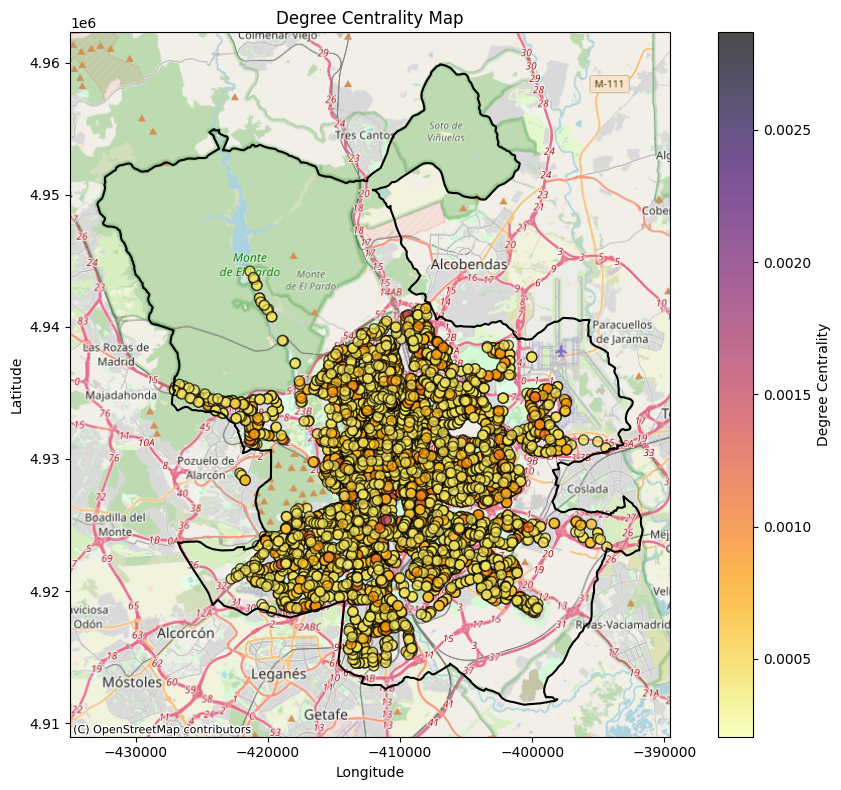

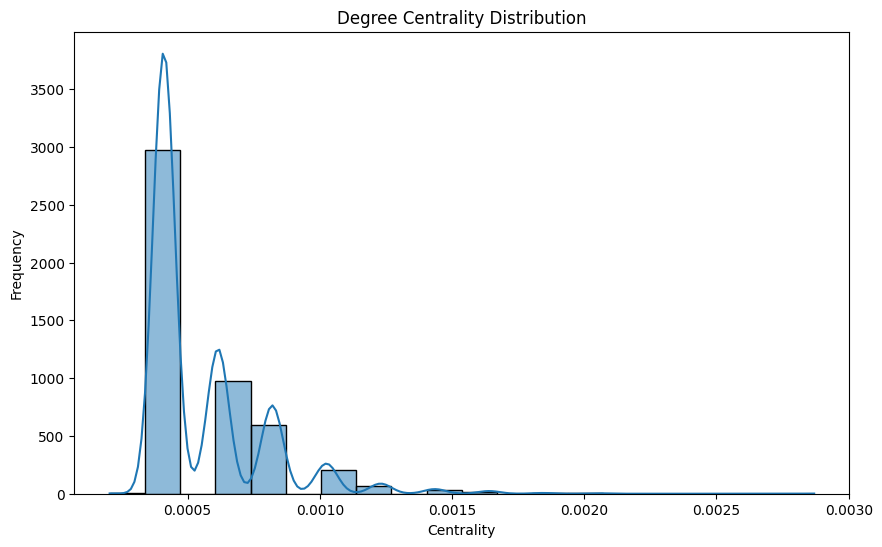

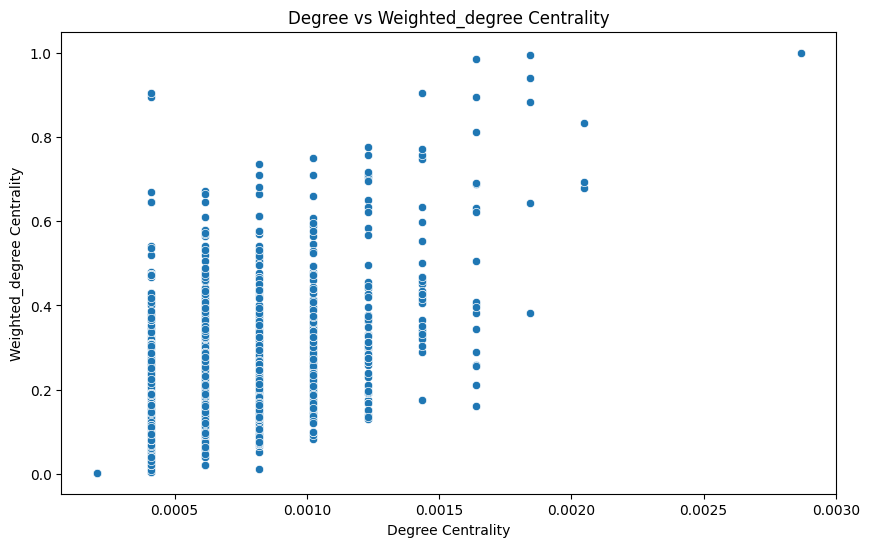

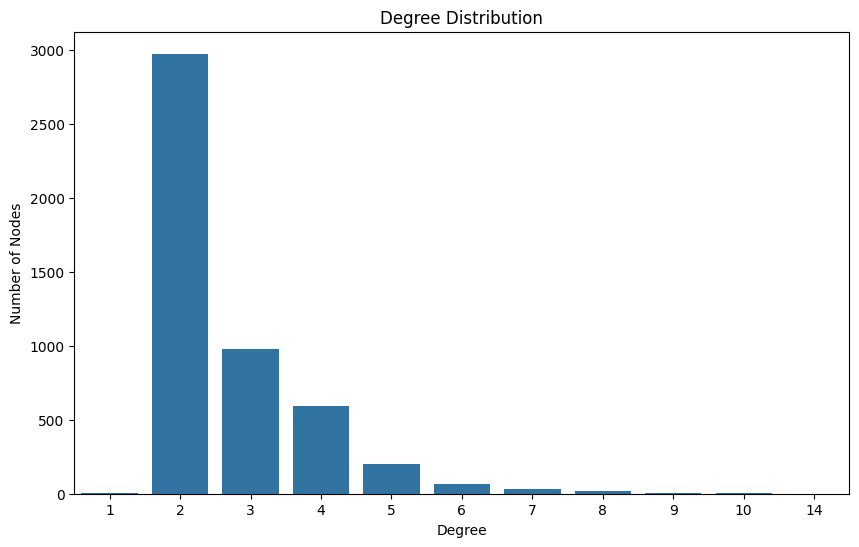

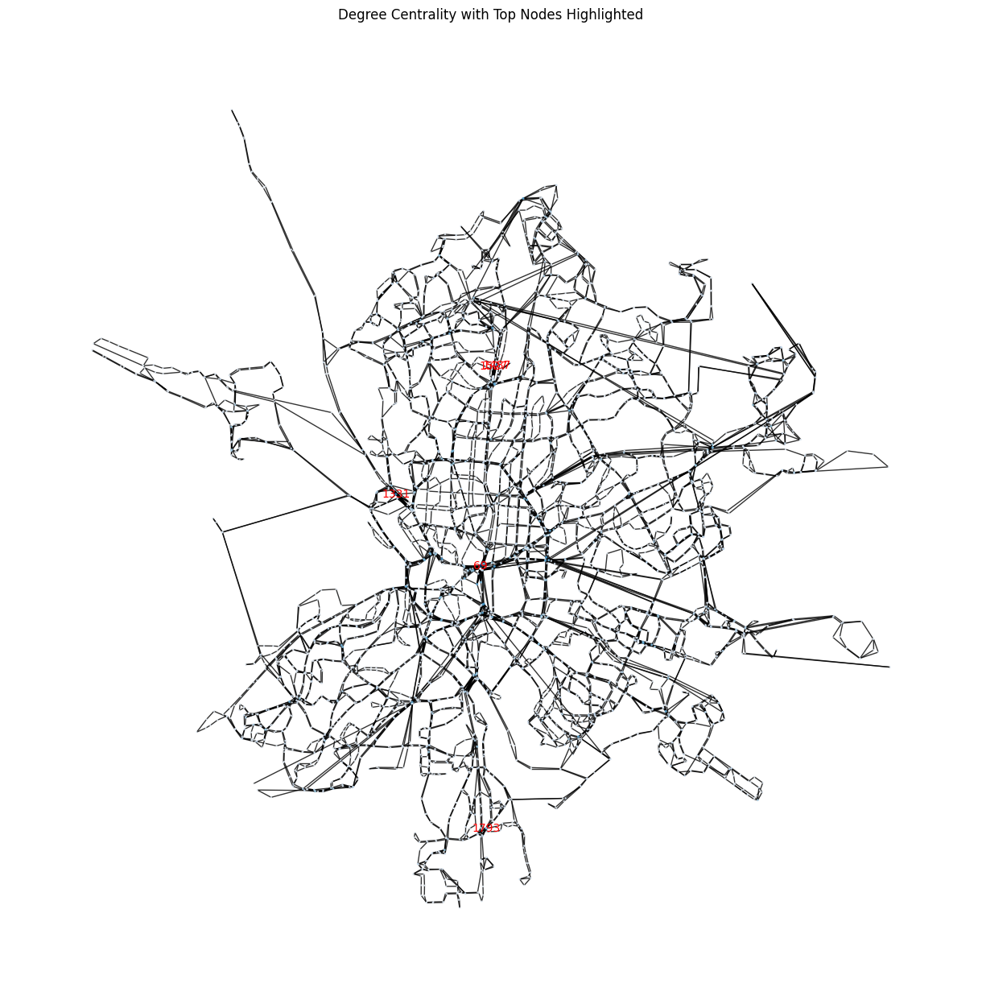


Network map saved as 'madridt_network.html'
K-Means clustering completed with 5 clusters.


C:\Users\moham\AppData\Local\Temp\ipykernel_37044\3263476046.py:268: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.



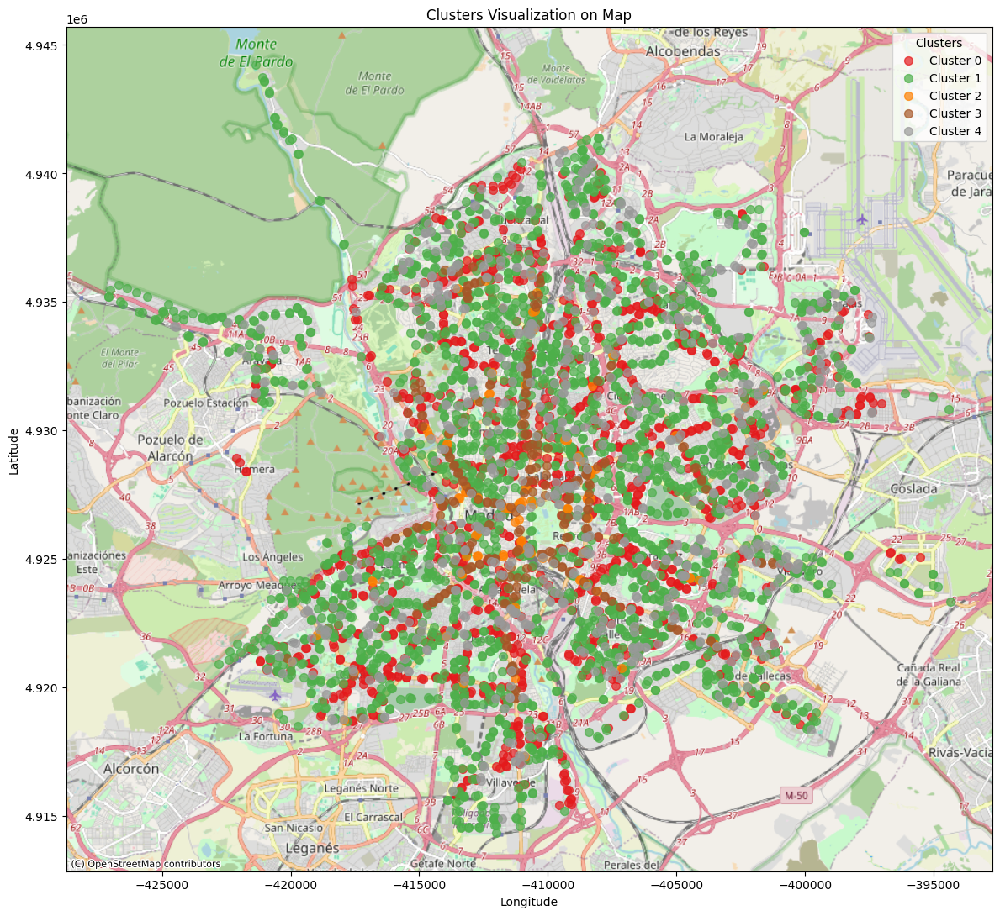

In [251]:
if __name__ == "__main__":
    DOfC = DegreeOfCentrality('./data/madrid')
    DOfC.load_data()
    DOfC.build_graph(directed=False, weighted=True)
    DOfC.compute_all_centrality_measures()

    measures = ['degree', 'weighted_degree']
    for measure in measures:
        top_stops = DOfC.get_top_n_stops_by_centrality(centrality_type=measure, n=5)
        print(f"\nTop 5 Stops by {measure.capitalize()} Centrality:")
        for stop_id, stop_name, centrality in top_stops:
            print(f"Stop ID: {stop_id}, Stop Name: {stop_name}, {measure.capitalize()} Centrality: {centrality:.4f}")

    # latitude_of_the_map = 40.4168,longitude_of_the_map = 3.7038
    
    network_map = DOfC.visualize_network(centrality_measure='degree', shapefile_path="./Betweeness_modularity_data/Madrid_map/Madrid_ETRS89.shp",frame_code_x="EPSG:3857",frame_code_y="EPSG:4326")
    network_map

    DOfC.plot_degree_centrality_histogram(centrality_type='degree', bins=20)
    DOfC.plot_centrality_scatter(centrality_x='degree', centrality_y='weighted_degree')
    DOfC.plot_degree_distribution()
    DOfC.visualize_network_top_nodes(centrality_type='degree', top_n=5, figsize=(12, 12))
    print("\nNetwork map saved as 'madridt_network.html'")
    
    DOfC.perform_kmeans_clustering(n_clusters=5, features=['degree','weighted_degree'])
    DOfC.visualize_clusters(figsize=(12, 12))



## K-Cores and Core Periphery Structure 

In [219]:
class KCore:
    def __init__(self, graph):

        self.graph = graph
        self.core_numbers = None

    def compute_k_core_decomposition(self):

        self.core_numbers = nx.core_number(self.graph)
        nx.set_node_attributes(self.graph, self.core_numbers, 'core_number')
        print("K-Core decomposition completed.")

    def visualize_k_cores(self, figsize=(12, 12)):
        if self.core_numbers is None:
            print("Please compute K-Core decomposition before visualization.")
            return

        pos = nx.spring_layout(self.graph, seed=42)

        core_nums = [self.graph.nodes[node]['core_number'] for node in self.graph.nodes()]
        max_core = max(core_nums)
        min_core = min(core_nums)

        fig, ax = plt.subplots(figsize=figsize)

        nodes = nx.draw_networkx_nodes(
            self.graph,
            pos,
            node_size=50,
            node_color=core_nums,
            cmap=plt.cm.get_cmap('coolwarm', max_core - min_core + 1),
            ax=ax  
        )

        nx.draw_networkx_edges(
            self.graph,
            pos,
            edge_color='gray',
            alpha=0.5,
            ax=ax  
        )

        sm = plt.cm.ScalarMappable(cmap=plt.cm.get_cmap('coolwarm', max_core - min_core + 1))
        sm.set_array([])
        cbar = fig.colorbar(sm, ax=ax, ticks=range(min_core, max_core + 1))
        cbar.set_label('Core Number')

        ax.set_title("Network Graph with Nodes Colored by Core Number")
        ax.axis('off')
        plt.show()


    def visualize_core_periphery(self, figsize=(12, 12)):

        if self.core_numbers is None:
            print("Please compute K-Core decomposition before visualization.")
            return

        pos = nx.spring_layout(self.graph, seed=42)

        max_core = max(self.core_numbers.values())
        core_nodes = [node for node, core in self.core_numbers.items() if core == max_core]
        periphery_nodes = [node for node in self.graph.nodes() if node not in core_nodes]

        plt.figure(figsize=figsize)

        nx.draw_networkx_nodes(
            self.graph,
            pos,
            nodelist=periphery_nodes,
            node_size=30,
            node_color='lightgray',
            alpha=0.7,
            label='Periphery'
        )

        nx.draw_networkx_nodes(
            self.graph,
            pos,
            nodelist=core_nodes,
            node_size=50,
            node_color='red',
            label='Core'
        )

        nx.draw_networkx_edges(
            self.graph,
            pos,
            edge_color='gray',
            alpha=0.5
        )

        plt.legend(scatterpoints=1)

        plt.title("Network Graph Highlighting Core and Periphery")
        plt.axis('off')
        plt.show()

    def visualize_all_k_cores(self, figsize=(12, 12)):

        if self.core_numbers is None:
            print("Please compute K-Core decomposition before visualization.")
            return

        pos = nx.spring_layout(self.graph, seed=42)

        core_levels = sorted(set(self.core_numbers.values()))
        num_levels = len(core_levels)

        colors = plt.cm.get_cmap('viridis', num_levels)
        color_mapping = {core: colors(i) for i, core in enumerate(core_levels)}
        node_colors = [color_mapping[self.core_numbers[node]] for node in self.graph.nodes()]

        plt.figure(figsize=figsize)

        nx.draw_networkx_nodes(
            self.graph,
            pos,
            node_size=50,
            node_color=node_colors
        )
        nx.draw_networkx_edges(
            self.graph,
            pos,
            edge_color='gray',
            alpha=0.5
        )
        legend_handles = [mpatches.Patch(color=color_mapping[core], label=f'Core {core}') for core in core_levels]
        plt.legend(handles=legend_handles, title='K-Cores', scatterpoints=1)

        plt.title("Network Graph with Nodes Colored by Core Number")
        plt.axis('off')
        plt.show()

    def visualize_specific_k_core(self, k, figsize=(12, 12)):

        if self.core_numbers is None:
            print("Please compute K-Core decomposition before visualization.")
            return

        k_core_subgraph = nx.k_core(self.graph, k=k)

        pos = nx.spring_layout(k_core_subgraph, seed=42)

        plt.figure(figsize=figsize)

        nx.draw_networkx_nodes(
            k_core_subgraph,
            pos,
            node_size=50,
            node_color='red'
        )

        nx.draw_networkx_edges(
            k_core_subgraph,
            pos,
            edge_color='gray',
            alpha=0.5
        )

        plt.title(f"Visualization of the {k}-Core Subgraph")
        plt.axis('off')
        plt.show()

    def analyze_core_distribution(self):

        if self.core_numbers is None:
            print("Please compute K-Core decomposition first.")
            return

        from collections import Counter

        core_counts = Counter(self.core_numbers.values())
        print("Core Number: Number of Nodes")
        for core_num in sorted(core_counts.keys()):
            print(f"{core_num}: {core_counts[core_num]}")

        core_nums = list(core_counts.keys())
        counts = list(core_counts.values())

        plt.figure(figsize=(8, 6))
        sns.barplot(x=core_nums, y=counts, palette='viridis')
        plt.xlabel('Core Number')
        plt.ylabel('Number of Nodes')
        plt.title('Distribution of Nodes Across Cores')
        plt.show()

    def get_top_nodes_in_core(self, k, centrality_measure='degree', n=5):

        if self.core_numbers is None:
            print("Please compute K-Core decomposition first.")
            return

        k_core_subgraph = nx.k_core(self.graph, k=k)

        if centrality_measure == 'degree':
            centrality = nx.degree_centrality(k_core_subgraph)
        else:
            print("Unsupported centrality measure.")
            return

        top_nodes = sorted(centrality.items(), key=lambda x: x[1], reverse=True)[:n]
        for node, cent_value in top_nodes:
            # stop_name = self.graph.nodes[node]['stop_name']
            print(f"Node: {node}, {centrality_measure.capitalize()} Centrality: {cent_value:.4f}")

    def enhanced_visualize_k_cores(self, figsize=(12, 12)):
        if self.core_numbers is None:
            print("Please compute K-Core decomposition before visualization.")
            return

        pos = nx.spring_layout(self.graph, seed=42)

        core_nums = [self.graph.nodes[node]['core_number'] for node in self.graph.nodes()]
        max_core = max(core_nums)
        min_core = min(core_nums)

        degree_centrality = nx.degree_centrality(self.graph)
        node_sizes = [degree_centrality[node] * 1000 for node in self.graph.nodes()]

        fig, ax = plt.subplots(figsize=figsize)

        nodes = nx.draw_networkx_nodes(
            self.graph,
            pos,
            node_size=node_sizes,
            node_color=core_nums,
            cmap='plasma',
            alpha=0.9,
            ax=ax
        )

        nx.draw_networkx_edges(
            self.graph,
            pos,
            edge_color='lightgray',
            alpha=0.5,
            ax=ax
        )

        sm = plt.cm.ScalarMappable(cmap='plasma', norm=plt.Normalize(vmin=min_core, vmax=max_core))
        sm.set_array([])
        cbar = fig.colorbar(sm, ax=ax)
        cbar.set_label('Core Number')

        ax.set_title("Enhanced K-Core Visualization")
        ax.axis('off')
        plt.show()


    def visualize_all_k_cores_radial(self, figsize=(12, 12)):
        if self.core_numbers is None:
            print("Please compute K-Core decomposition first.")
            return

        import matplotlib.patches as mpatches

        core_values = sorted(set(self.core_numbers.values()))
        min_core = min(core_values)
        max_core = max(core_values)
        num_cores = len(core_values)

        cmap = plt.cm.get_cmap('viridis', num_cores)

        color_mapping = {core: cmap(i) for i, core in enumerate(core_values)}

        nodes_by_core = {}
        for node, c in self.core_numbers.items():
            nodes_by_core.setdefault(c, []).append(node)

        core_to_radius = {}
        for i, c in enumerate(reversed(core_values)):
            core_to_radius[c] = i + 1

        pos = {}
        for c, nodes_in_core in nodes_by_core.items():
            radius = core_to_radius[c]
            angle_increment = 2 * np.pi / len(nodes_in_core)
            for i, node in enumerate(nodes_in_core):
                angle = i * angle_increment
                x = radius * np.cos(angle)
                y = radius * np.sin(angle)
                pos[node] = (x, y)

        node_colors = [color_mapping[self.core_numbers[node]] for node in self.graph.nodes()]

        fig, ax = plt.subplots(figsize=figsize)
        nx.draw_networkx_edges(self.graph, pos, edge_color='gray', alpha=0.5, ax=ax)
        nx.draw_networkx_nodes(
            self.graph, pos, node_color=node_colors, node_size=50, ax=ax
        )

        legend_handles = []
        for c in core_values:
            patch = mpatches.Patch(color=color_mapping[c], label=f'Core {c}')
            legend_handles.append(patch)

        ax.legend(handles=legend_handles, title='K-Cores', loc='best')

        ax.set_title("Radial K-Core Layout")
        ax.axis('off')
        plt.show()

K-Core decomposition completed.
Core Number: Number of Nodes
0: 80
1: 70
2: 46


C:\Users\moham\AppData\Local\Temp\ipykernel_37044\1925129032.py:182: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




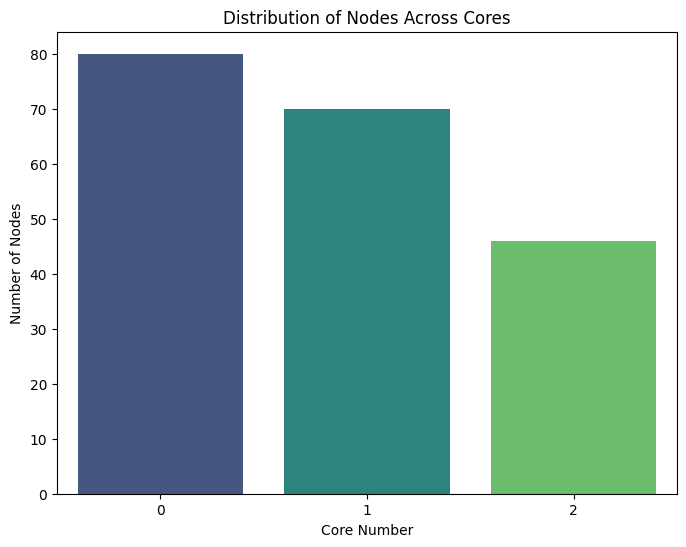

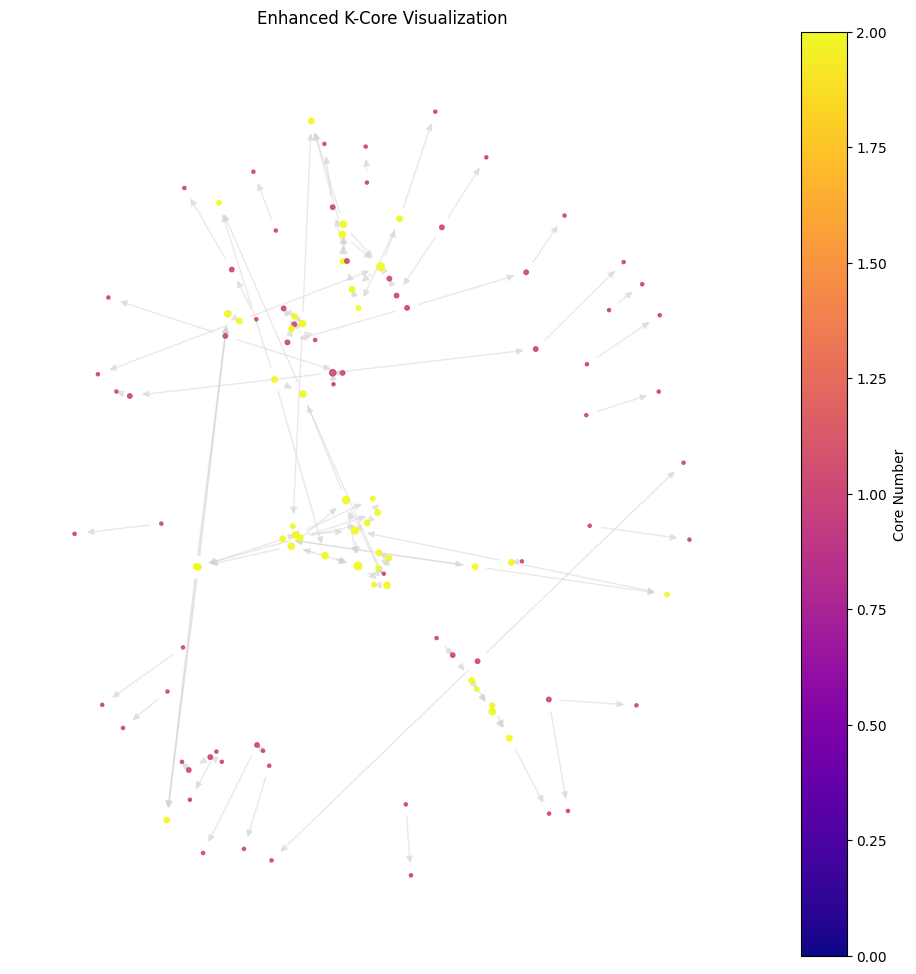

C:\Users\moham\AppData\Local\Temp\ipykernel_37044\1925129032.py:263: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.



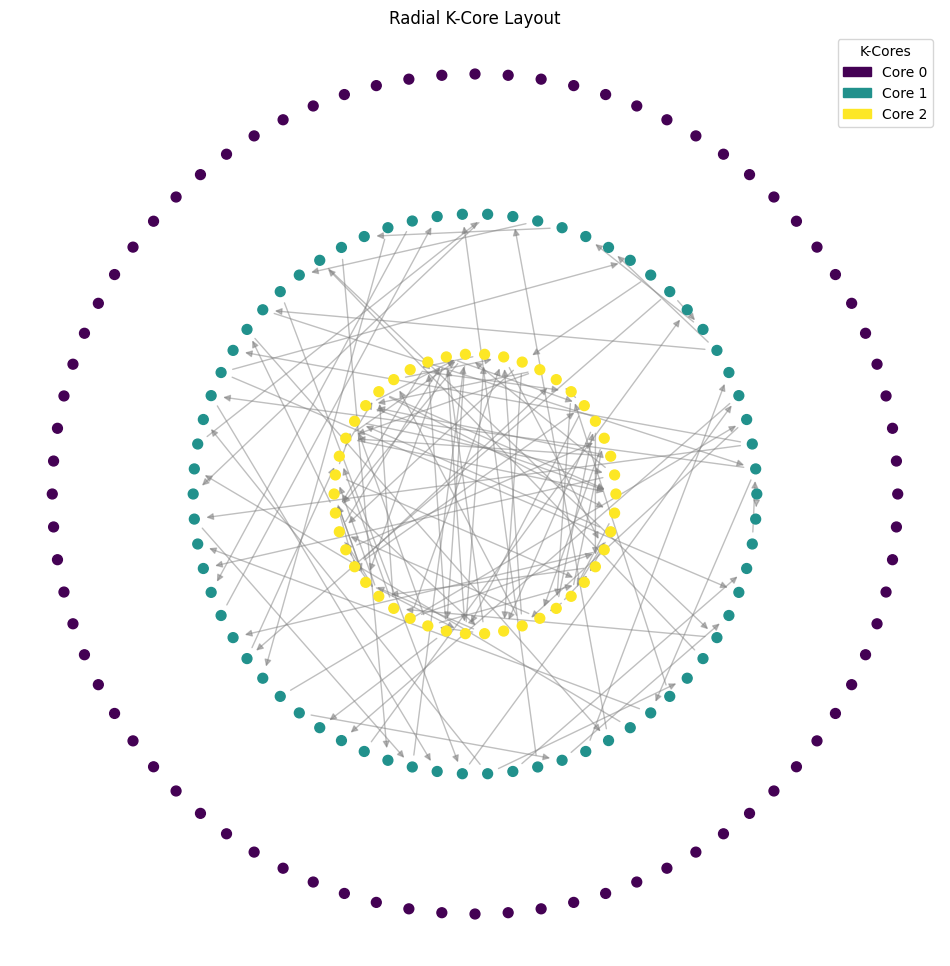

In [220]:
doc_brussels = DegreeOfCentrality('./data/brussels')
doc_brussels.load_data()
doc_brussels.build_graph(directed=True, weighted=False)


doc_brussels.compute_degree_centrality()
centrality_threshold = 0.97  # Keep top 3%
filtered_nodes = [
    node for node, centrality in doc_brussels.degree_centrality.items() 
    if centrality >= sorted(doc_brussels.degree_centrality.values())[int(len(doc_brussels.degree_centrality) * centrality_threshold)]
]

G_brussels_filtered = doc_brussels.graph.subgraph(filtered_nodes)

kc_brussels = KCore(G_brussels_filtered)
kc_brussels.compute_k_core_decomposition()

kc_brussels.analyze_core_distribution()
kc_brussels.enhanced_visualize_k_cores(figsize=(12, 12))

kc_brussels.visualize_all_k_cores_radial(figsize=(12, 12))


K-Core decomposition completed.
Core Number: Number of Nodes
0: 100
1: 179
2: 51


C:\Users\moham\AppData\Local\Temp\ipykernel_37044\1925129032.py:182: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




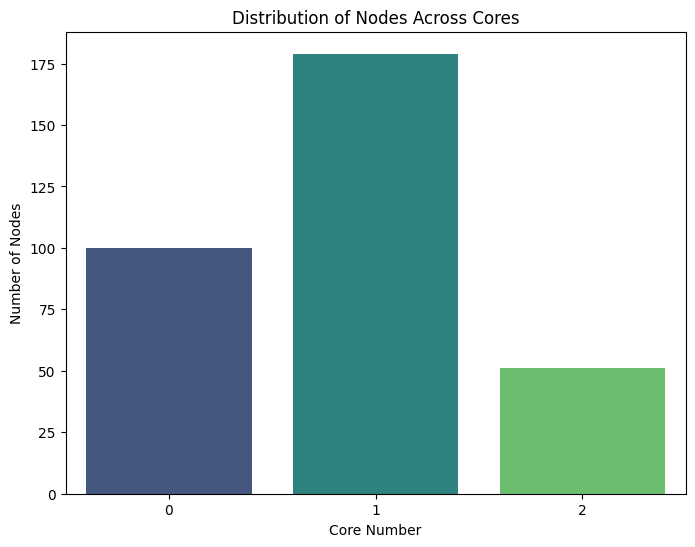

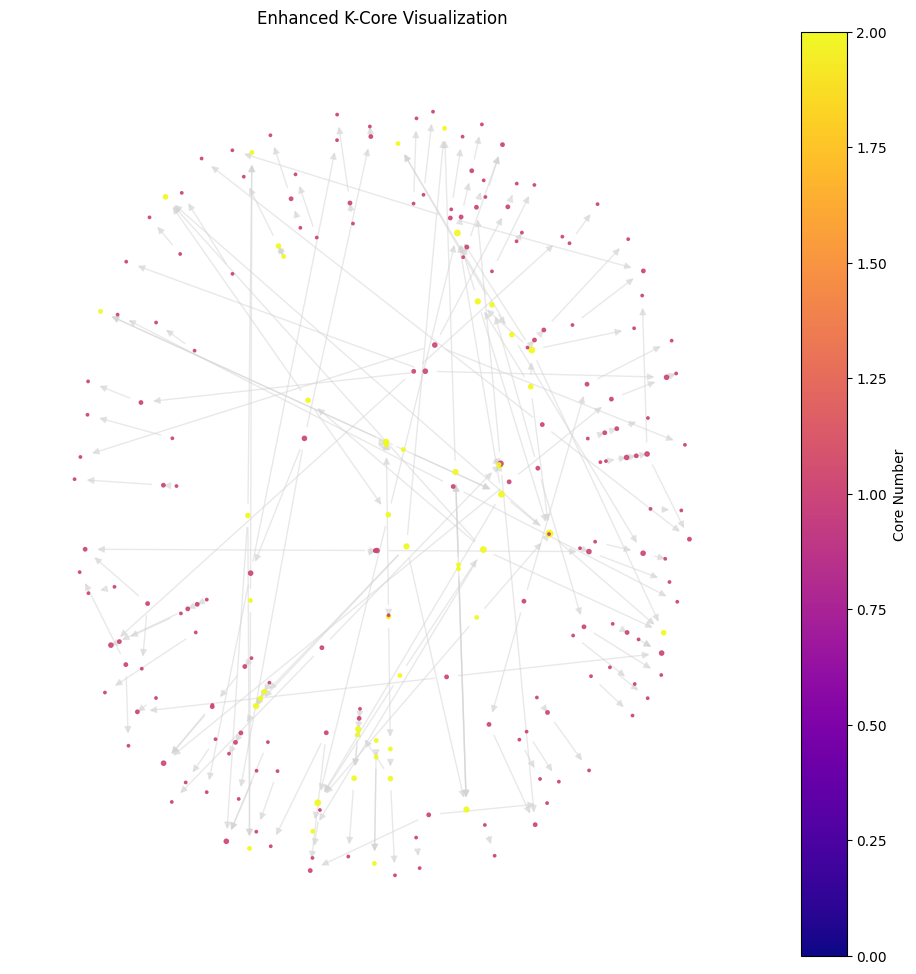

C:\Users\moham\AppData\Local\Temp\ipykernel_37044\1925129032.py:263: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.



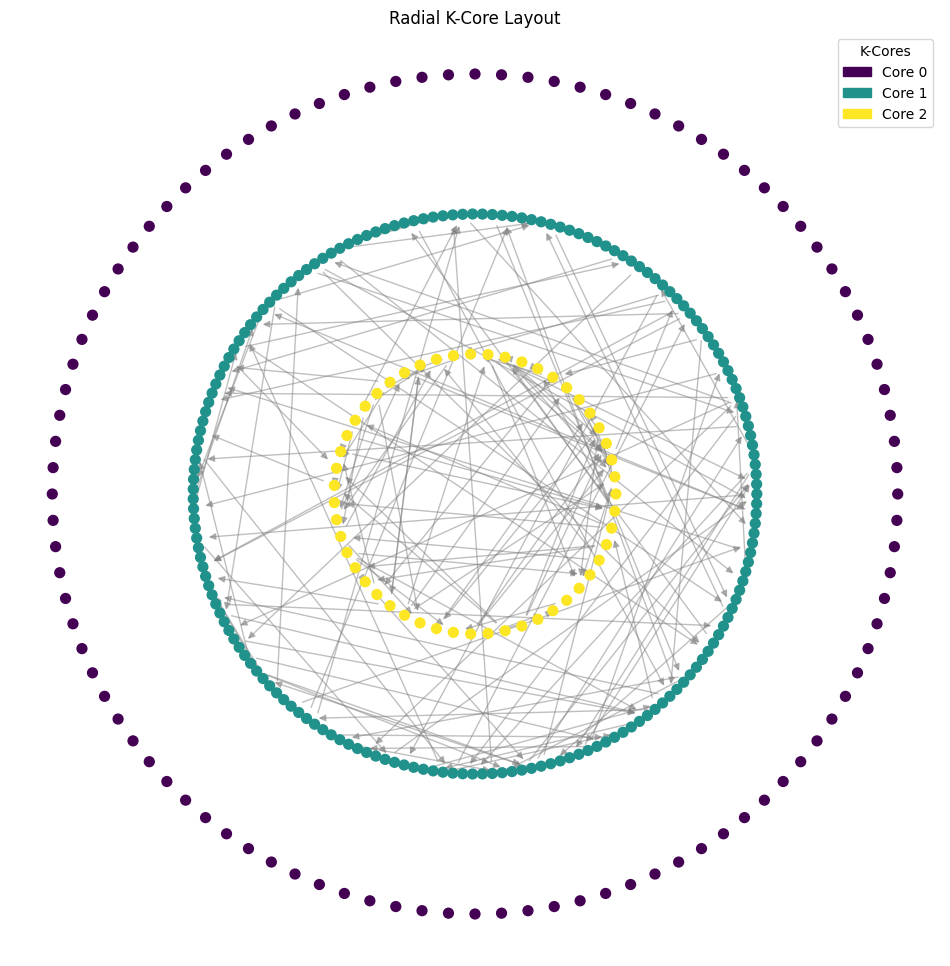

In [221]:
doc_madrid = DegreeOfCentrality('./data/madrid')

doc_madrid.load_data()
doc_madrid.build_graph(directed=True, weighted=True)
doc_madrid.compute_degree_centrality()
centrality_threshold = 0.97  # Keep top 3%
filtered_nodes = [
    node for node, centrality in doc_madrid.degree_centrality.items() 
    if centrality >= sorted(doc_madrid.degree_centrality.values())[int(len(doc_madrid.degree_centrality) * centrality_threshold)]
]

G_brussels_filtered = doc_madrid.graph.subgraph(filtered_nodes)

kc_brussels = KCore(G_brussels_filtered)
kc_brussels.compute_k_core_decomposition()
kc_brussels.analyze_core_distribution()
kc_brussels.enhanced_visualize_k_cores(figsize=(12, 12))
kc_brussels.visualize_all_k_cores_radial(figsize=(12, 12))

In [208]:
doc_brussels = DegreeOfCentrality('./data/brussels')
doc_madrid = DegreeOfCentrality('./data/madrid')

doc_brussels.load_data()
doc_madrid.load_data()
doc_brussels.build_graph(directed=True, weighted=False)
doc_madrid.build_graph(directed=True, weighted=False)

print("Brussels unique stops:", len(doc_brussels.stops_df['stop_id'].unique()))
print("Madrid unique stops:", len(doc_madrid.stops_df['stop_id'].unique()))

print("Brussels:", doc_brussels.graph.number_of_nodes(), "nodes,", doc_brussels.graph.number_of_edges(), "edges")
print("Madrid:", doc_madrid.graph.number_of_nodes(), "nodes,", doc_madrid.graph.number_of_edges(), "edges")



Brussels unique stops: 2803
Madrid unique stops: 4880
Brussels: 2803 nodes, 2873 edges
Madrid: 4880 nodes, 6574 edges


# Betwenness modularity 

## weekly_trips_summary

In [93]:
def weekly_trips_summary(routes_df,trips_df,calendar_df,calendar_dates_df,filename):
    try:
        # Step 1: Calculate weekly service days for each service_id
        # Sum the number of active days (Mon-Sun) for each service_id in calendar.txt
        calendar_df['weekly_active_days'] = calendar_df[['monday', 'tuesday', 'wednesday', 'thursday', 'friday', 'saturday', 'sunday']].sum(axis=1)

        # Step 2: Merge trips with calendar to link trips to service days
        trips_with_service = pd.merge(trips_df, calendar_df[['service_id', 'weekly_active_days']], on='service_id', how='left')

        # Step 3: Compute weekly trips per route
        # Multiply the number of weekly active days by the number of trips for each route_id
        trips_with_service['weekly_trips'] = trips_with_service['weekly_active_days']

        # Group by route_id and sum up weekly trips
        weekly_trips_per_route = trips_with_service.groupby('route_id')['weekly_trips'].sum().reset_index()

        # Step 4: Merge with route details for human-readable output
        weekly_trips_summary = pd.merge(weekly_trips_per_route, routes_df, on='route_id', how='left')

        # Display result
        print(weekly_trips_summary[['route_id', 'route_short_name', 'route_long_name', 'weekly_trips']])
        print("Total routes: ", len(weekly_trips_summary))

        # Save to CSV (optional)
        weekly_trips_summary.to_csv(f"./Betweeness_modularity_data/weekly_trips_per_route_{filename}.csv", index=False)
    except Exception as error:
        print(f"There is an Error in weekly_trips_summary function error: {error}")


### weekly_trips_summary for Brussels

In [94]:
routes_df = pd.read_csv("./data/brussels/routes.txt")
trips_df = pd.read_csv("./data/brussels/trips.txt")
calendar_df = pd.read_csv("./data/brussels/calendar.txt")
calendar_dates_df = pd.read_csv("./data/brussels/calendar_dates.txt")
weekly_trips_summary(routes_df,trips_df,calendar_df,calendar_dates_df,"brussels")

    route_id route_short_name                  route_long_name  weekly_trips
0          1                1        GARE DE L'OUEST - STOCKEL          2261
1          2                5        ERASME - HERRMANN-DEBROUX          2332
2          3                2              SIMONIS - ELISABETH          2123
3          4                6         ROI BAUDOUIN - ELISABETH          2181
4          5                4        GARE DU NORD - STALLE (P)          2267
..       ...              ...                              ...           ...
86        87              240          CERIA - FOREST NATIONAL            68
87        88               T8               LOUISE - ROODEBEEK          1704
88        89              T44    MONTGOMERY - TERVUREN STATION          1176
89        90              T92      SCHAERBEEK GARE - FORT-JACO          1757
90        91               T9  GROOT-BIJGAARDEN - ROI BAUDOUIN          2694

[91 rows x 4 columns]
Total routes:  91


### weekly_trips_summary for Madrid

In [95]:
routes_df = pd.read_csv("./data/madrid/routes.txt")
trips_df = pd.read_csv("./data/madrid/trips.txt")
calendar_df = pd.read_csv("./data/madrid/calendar.txt")
calendar_dates_df = pd.read_csv("./data/madrid/calendar_dates.txt")
weekly_trips_summary(routes_df,trips_df,calendar_df,calendar_dates_df,"madrid")

     route_id route_short_name  \
0           1                1   
1           2                2   
2           3                3   
3           4                4   
4           5                5   
..        ...              ...   
226       730            SE730   
227       766            SE766   
228       831              BR1   
229       832            SE832   
230       833            SE833   

                                      route_long_name  weekly_trips  
0                   Plaza de Cristo Rey - Prosperidad           999  
1    Plaza de Manuel Becerra - Avenida Reina Victoria          1469  
2               Puerta de Toledo - Plaza de San Amaro          1328  
3          Plaza de Ciudad Lineal - Puerta de Arganda          1174  
4      Puerta del Sol/sevilla - Estacion de Chamartin          1108  
..                                                ...           ...  
226                Plaza Eliptica - Pinar de San Jose            42  
227          Atocha - Poligono 

## Adjacency Matrix

In [113]:
def adjacency_matrix(stop_times_df, calendar_df, trips_df,file_name):
    try:
        trips_df['service_id'] = trips_df['service_id'].astype(str)
        calendar_df['service_id'] = calendar_df['service_id'].astype(str)

        calendar_df['weekly_active_days'] = calendar_df[['monday', 'tuesday', 'wednesday', 'thursday', 'friday', 'saturday', 'sunday']].sum(axis=1)

        trips_with_service = pd.merge(trips_df, calendar_df[['service_id', 'weekly_active_days']], on='service_id', how='left')

        trips_with_service['weekly_trips'] = trips_with_service['weekly_active_days']

        stop_times_with_trips = pd.merge(stop_times_df, trips_with_service[['trip_id', 'weekly_trips']], on='trip_id', how='left')

        stop_times_with_trips.sort_values(by=['trip_id', 'stop_sequence'], inplace=True)
        stop_times_with_trips['next_stop_id'] = stop_times_with_trips.groupby('trip_id')['stop_id'].shift(-1)

        stop_times_with_trips = stop_times_with_trips.dropna(subset=['next_stop_id'])

        edges = stop_times_with_trips.groupby(['stop_id', 'next_stop_id'])['weekly_trips'].sum().reset_index()

        stop_ids = pd.concat([edges['stop_id'], edges['next_stop_id']]).unique()
        stop_id_to_index = {stop_id: i for i, stop_id in enumerate(stop_ids)}

        adj_matrix = np.zeros((len(stop_ids), len(stop_ids)))

        for _, row in edges.iterrows():
            i = stop_id_to_index[row['stop_id']]
            j = stop_id_to_index[row['next_stop_id']]
            adj_matrix[i, j] = row['weekly_trips']

        adj_matrix_df = pd.DataFrame(adj_matrix, index=stop_ids, columns=stop_ids)
        adj_matrix_df.to_csv(f"./Betweeness_modularity_data/adjacency_matrix_{file_name}.csv")
        print(adj_matrix_df)
    except Exception as error:
        print(f"There is an Error in adjacency_matrix function error: {error}")


### adjacency_matrix for Brussels

In [114]:
calendar_df = pd.read_csv("./data/brussels/calendar.txt")
stops_df = pd.read_csv("./data/brussels/stops.txt")
stop_times_df = pd.read_csv("./data/brussels/stop_times.txt")
trips_df = pd.read_csv("./data/brussels/trips.txt")
adjacency_matrix(stop_times_df,calendar_df,trips_df,"brussels")

      0089  0472    0501  0506  0511    0516  0521  0526  0529  0531  ...  \
0089   0.0   0.0     0.0   0.0   0.0     0.0   0.0   0.0   0.0   0.0  ...   
0472   0.0   0.0     0.0   0.0   0.0     0.0   0.0   0.0   0.0   0.0  ...   
0501   0.0   0.0     0.0   0.0   0.0     0.0   0.0   0.0   0.0   0.0  ...   
0506   0.0   0.0     0.0   0.0   0.0  2016.0   0.0   0.0   0.0   0.0  ...   
0511   0.0   0.0  2029.0   0.0   0.0     0.0   0.0   0.0   0.0   0.0  ...   
...    ...   ...     ...   ...   ...     ...   ...   ...   ...   ...  ...   
5320   0.0   0.0     0.0   0.0   0.0     0.0   0.0   0.0   0.0   0.0  ...   
4265   0.0   0.0     0.0   0.0   0.0     0.0   0.0   0.0   0.0   0.0  ...   
1390   0.0   0.0     0.0   0.0   0.0     0.0   0.0   0.0   0.0   0.0  ...   
7305   0.0   0.0     0.0   0.0   0.0     0.0   0.0   0.0   0.0   0.0  ...   
8472   0.0   0.0     0.0   0.0   0.0     0.0   0.0   0.0   0.0   0.0  ...   

      5776  6486G  0712F  4502F  9952G  5320  4265  1390  7305  8472  
0089

### adjacency_matrix for Madrid

In [115]:
calendar_df = pd.read_csv("./data/madrid/calendar.txt")
stops_df = pd.read_csv("./data/madrid/stops.txt")
stop_times_df = pd.read_csv("./data/madrid/stop_times.txt")
trips_df = pd.read_csv("./data/madrid/trips.txt")
adjacency_matrix(stop_times_df,calendar_df,trips_df,"madrid")

         1.0      2.0      3.0      4.0      5.0      6.0      7.0      \
1.0          0.0    579.0      0.0      0.0      0.0      0.0      0.0   
2.0          0.0      0.0      0.0      0.0      0.0      0.0      0.0   
3.0          0.0      0.0      0.0    579.0      0.0      0.0      0.0   
4.0          0.0      0.0      0.0      0.0    579.0      0.0      0.0   
5.0          0.0      0.0      0.0      0.0      0.0      0.0      0.0   
...          ...      ...      ...      ...      ...      ...      ...   
51111.0      0.0      0.0      0.0      0.0      0.0      0.0      0.0   
51112.0      0.0      0.0      0.0      0.0      0.0      0.0      0.0   
51113.0      0.0      0.0      0.0      0.0      0.0      0.0      0.0   
51114.0      0.0      0.0      0.0      0.0      0.0      0.0      0.0   
51116.0      0.0      0.0      0.0      0.0      0.0      0.0      0.0   

         8.0      9.0      11.0     ...  51097.0  51099.0  51100.0  51106.0  \
1.0          0.0      0.0      0

## Betweenness centrality

In [116]:
def betweenness_centrality(filename):
    try:
        adj_matrix_df = pd.read_csv(f"./Betweeness_modularity_data/adjacency_matrix_{filename}.csv", index_col=0)

        # Convert adjacency matrix to a numpy array
        adj_matrix = adj_matrix_df.values

        # Create a directed graph from the adjacency matrix
        G = nx.from_numpy_array(adj_matrix, create_using=nx.DiGraph)

        # Relabel nodes with stop IDs for clarity (optional)
        mapping = {i: stop_id for i, stop_id in enumerate(adj_matrix_df.index)}
        G = nx.relabel_nodes(G, mapping)
        # Calculate betweenness centrality
        betweenness_centrality = nx.betweenness_centrality(G, weight= 'weight')

        # Convert results to a DataFrame for easier interpretation
        betweenness_centrality_df = pd.DataFrame(
            list(betweenness_centrality.items()), 
            columns=['stop_id', 'betweenness_centrality']
        )

        # Sort by centrality (descending order)
        betweenness_centrality_df = betweenness_centrality_df.sort_values(by='betweenness_centrality', ascending=False)
        # Save to CSV (optional)
        betweenness_centrality_df.to_csv(f"./Betweeness_modularity_data/betwenness_centrality_{filename}.csv", index=False)

        # Print the top stops by betweenness centrality
        print(betweenness_centrality_df.head())
    except Exception as error:
        print(f"There is an Error in adjacency_matrix function error: {error}")


### betweenness_centrality brussels

In [117]:
betweenness_centrality("brussels")

     stop_id  betweenness_centrality
114     1124                0.088150
1650    4952                0.087418
2165    6465                0.082614
2137    6432                0.080004
142    1162C                0.079710


### betweenness_centrality madrid

In [118]:
betweenness_centrality("madrid")

      stop_id  betweenness_centrality
4612   5727.0                0.171334
700     789.0                0.158334
720     811.0                0.143681
125     150.0                0.140621
1274   1427.0                0.140387


### map_graph_of_betweenness_centrality_brussels

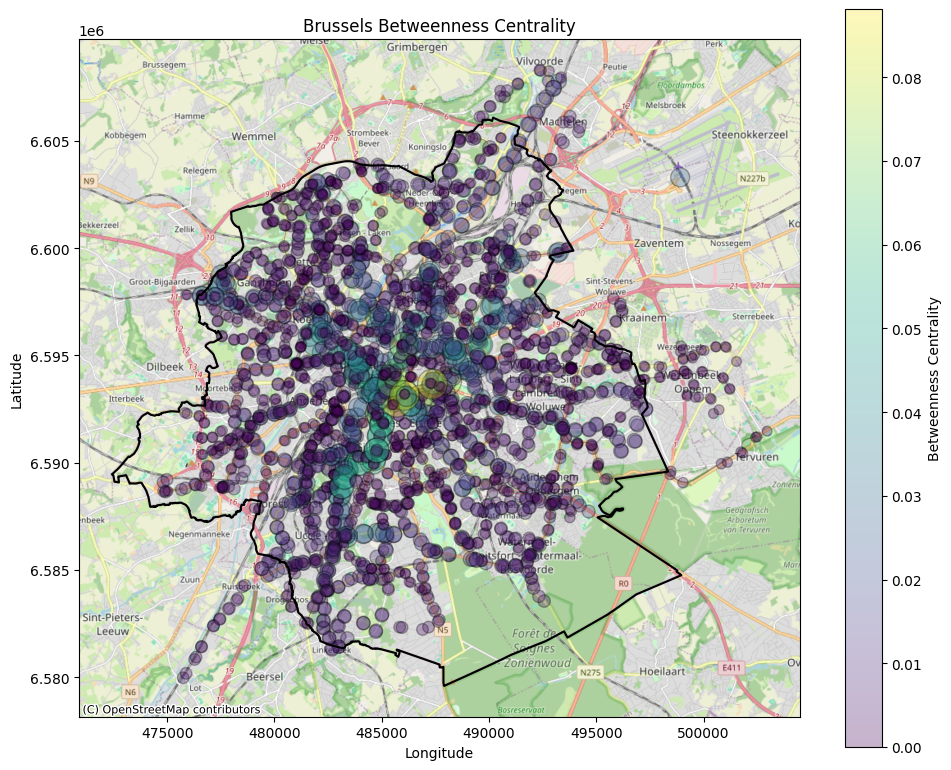

In [ ]:


def map_graph_of_betweenness_centrality_brussels(stops_df,betweenness_centrality_df):
        
    stops_with_centrality = stops_df.merge(betweenness_centrality_df, on="stop_id")


    # Reproject shapefile to EPSG:3857
    gdf = gpd.read_file("./Betweeness_modularity_data/Brussels_map/UrbAdm_REGION.shp").to_crs("EPSG:3857")

    # Transform stops data to EPSG:3857
    transformer = Transformer.from_crs("EPSG:4326", "EPSG:3857", always_xy=True)
    stops_with_centrality["stop_lon"], stops_with_centrality["stop_lat"] = transformer.transform(
        stops_with_centrality["stop_lon"].values,
        stops_with_centrality["stop_lat"].values,
    )

    # Drop NaN values
    stops_with_centrality = stops_with_centrality.dropna(subset=["stop_lon", "stop_lat", "betweenness_centrality"])

    # Create plot
    plt.figure(figsize=(10, 8))
    scatter = plt.scatter(
        stops_with_centrality["stop_lon"],
        stops_with_centrality["stop_lat"],
        c=stops_with_centrality["betweenness_centrality"],
        s=50 + 5000 * stops_with_centrality["betweenness_centrality"],  # Scale size
        cmap="viridis",
        alpha=0.3,
        edgecolor="k",
    )

    # Plot only the borders of the GeoDataFrame
    gdf.boundary.plot(ax=plt.gca(), color="black")  # Use `boundary.plot` for just borders

    # Add color bar and labels
    plt.colorbar(scatter, label="Betweenness Centrality")
    plt.xlabel("Longitude")
    plt.ylabel("Latitude")
    plt.title("Brussels Betweenness Centrality")
    ctx.add_basemap(plt.gca(), crs="EPSG:3857", source=ctx.providers.OpenStreetMap.Mapnik)
    plt.tight_layout()
    plt.show()
stops_df = pd.read_csv("./data/brussels/stops.txt")

betweenness_centrality_df= pd.read_csv("./Betweeness_modularity_data/betwenness_centrality_brussels.csv")
map_graph_of_betweenness_centrality_brussels(stops_df,betweenness_centrality_df)

### map_graph_of_betweenness_centrality_madrid

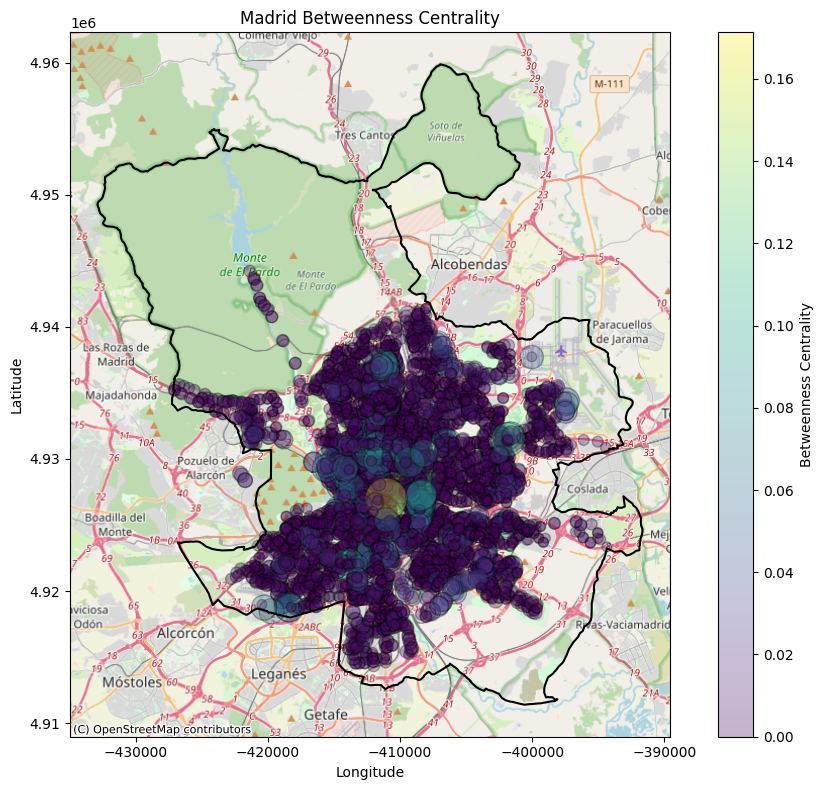

In [128]:


def map_graph_of_betweenness_centrality_madrid(stops_df,betweenness_centrality_df):
    from pyproj import Transformer

    stops_with_centrality = stops_df.merge(betweenness_centrality_df, on="stop_id")

    # Reproject shapefile to EPSG:3857
    gdf = gpd.read_file("./Betweeness_modularity_data/Madrid_map/Madrid_ETRS89.shp").to_crs("EPSG:3857")

    # Transform stops data to EPSG:3857
    transformer = Transformer.from_crs("EPSG:4326", "EPSG:3857", always_xy=True)
    stops_with_centrality["stop_lon"], stops_with_centrality["stop_lat"] = transformer.transform(
        stops_with_centrality["stop_lon"].values,
        stops_with_centrality["stop_lat"].values,
    )

    # Drop NaN values
    stops_with_centrality = stops_with_centrality.dropna(subset=["stop_lon", "stop_lat", "betweenness_centrality"])

    # Create plot
    plt.figure(figsize=(10, 8))
    scatter = plt.scatter(
        stops_with_centrality["stop_lon"],
        stops_with_centrality["stop_lat"],
        c=stops_with_centrality["betweenness_centrality"],
        s=50 + 5000 * stops_with_centrality["betweenness_centrality"],  # Scale size
        cmap="viridis",
        alpha=0.3,
        edgecolor="k",
    )

    # Plot only the borders of the GeoDataFrame
    gdf.boundary.plot(ax=plt.gca(), color="black")  # Use `boundary.plot` for just borders

    # Add color bar and labels
    plt.colorbar(scatter, label="Betweenness Centrality")
    plt.xlabel("Longitude")
    plt.ylabel("Latitude")
    plt.title("Madrid Betweenness Centrality")
    ctx.add_basemap(plt.gca(), crs="EPSG:3857", source=ctx.providers.OpenStreetMap.Mapnik)
    plt.tight_layout()
    plt.show()

stops_df = pd.read_csv("./data/madrid/stops.txt")

betweenness_centrality_df= pd.read_csv("./Betweeness_modularity_data/betwenness_centrality_madrid.csv")
map_graph_of_betweenness_centrality_madrid(stops_df,betweenness_centrality_df)

### betwennes centrality distribution brussels

In [133]:
def centrality_distribution(betweenness_centrality_df,filename):
    plt.hist(betweenness_centrality_df['betweenness_centrality'], bins=40)
    plt.xlabel(f'Betweenness Centrality {filename}')
    plt.ylabel('Frequency')
    plt.title(f'Distribution of Betweenness Centrality {filename}')
    plt.show()

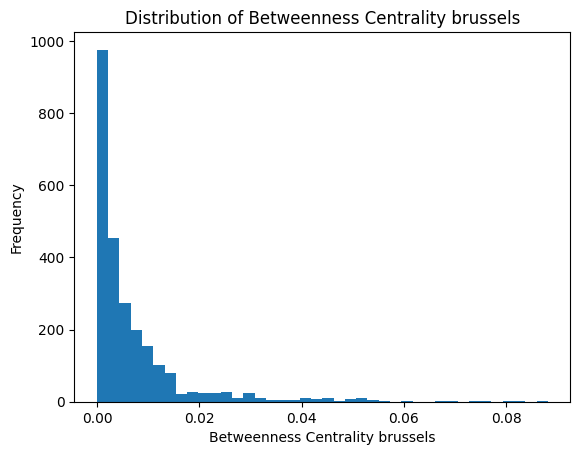

In [134]:

betweenness_centrality_df= pd.read_csv("./Betweeness_modularity_data/betwenness_centrality_brussels.csv")
centrality_distribution(betweenness_centrality_df,"brussels")


### betwennes centrality distribution madrid

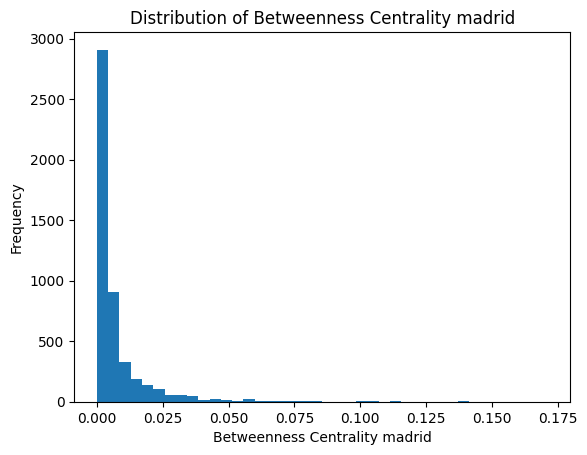

In [135]:
betweenness_centrality_df= pd.read_csv("./Betweeness_modularity_data/betwenness_centrality_madrid.csv")
centrality_distribution(betweenness_centrality_df,"madrid")

### Betweenness Centrality of Stops Brussels

In [137]:
def Betweenness_Centrality_of_Stops(betweenness_centrality_df,filename):
    # Assuming `betweenness_centrality_df` is a DataFrame
    betweenness_nodes = betweenness_centrality_df['stop_id'].tolist()
    betweenness_values = betweenness_centrality_df['betweenness_centrality'].tolist()

    # Sort the data by betweenness centrality in descending order
    sorted_data = sorted(zip(betweenness_values, betweenness_nodes), reverse=True)  # Sort in descending order
    sorted_values, sorted_nodes = zip(*sorted_data)  # Unzip into separate lists

    plt.figure(figsize=(12, 8))
    plt.bar(range(len(sorted_values)), sorted_values)  # Plot sorted values
    plt.xlabel('Stop ID (Sorted by Betweenness Centrality)')
    plt.xlim(-100, 7000)  # Adjust this range if needed
    plt.ylabel('Betweenness Centrality')
    plt.title(f'Betweenness Centrality of Stops (Sorted in Descending Order) {filename}')
    plt.xticks([], [])  # Hide x-axis tick labels
    plt.show()

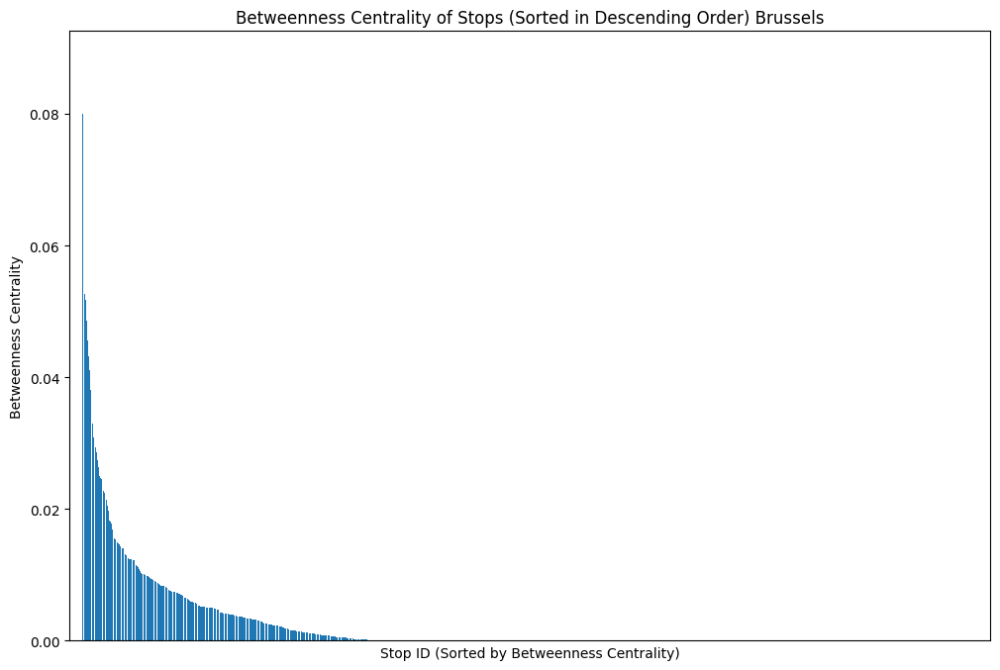

In [138]:
betweenness_centrality_df= pd.read_csv("./Betweeness_modularity_data/betwenness_centrality_brussels.csv")

Betweenness_Centrality_of_Stops(betweenness_centrality_df,"Brussels")

### Betweenness Centrality of Stops Madrid

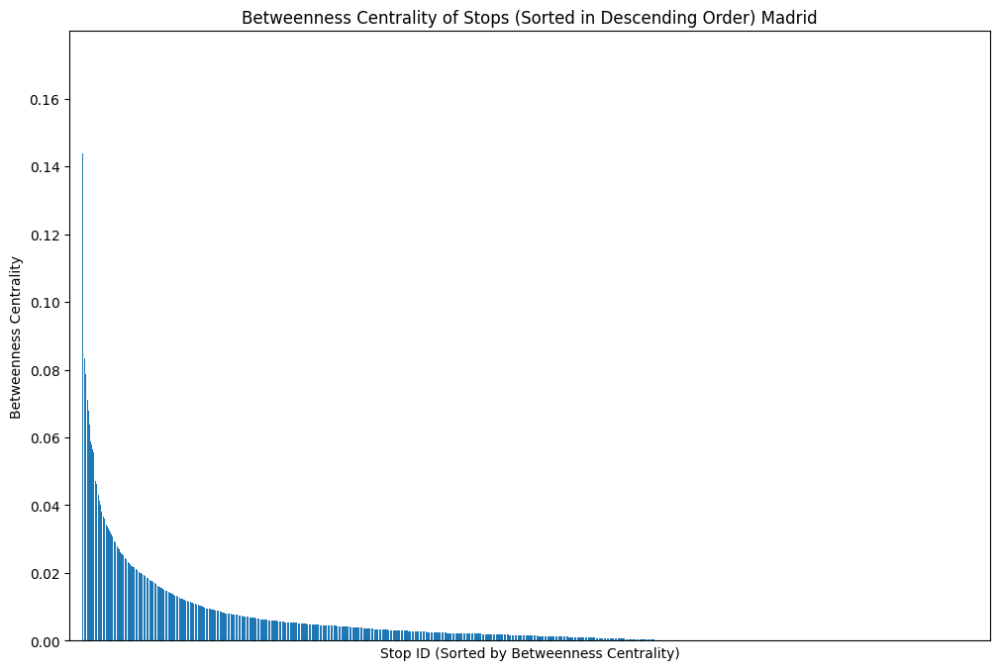

In [139]:
betweenness_centrality_df= pd.read_csv("./Betweeness_modularity_data/betwenness_centrality_madrid.csv")

Betweenness_Centrality_of_Stops(betweenness_centrality_df,"Madrid")

## betweenness centrality cumulative distribution

### betweenness centrality cumulative distribution Brussels

In [140]:
def betweenness_centrality_cumulative_distribution(betweenness_centrality_df,filename):
    values = list(betweenness_centrality_df['betweenness_centrality'])
    values.sort()

    # Compute the cumulative frequencies
    cumulative_frequencies = np.cumsum(np.ones(len(values)) / len(values))

    # Plot the cumulative distribution
    plt.plot(values, cumulative_frequencies)
    plt.xlabel('Betweenness Centrality')
    plt.ylabel('Cumulative Frequency')
    plt.title(f'Cumulative Distribution of Betweenness Centrality {filename}')
    plt.show()

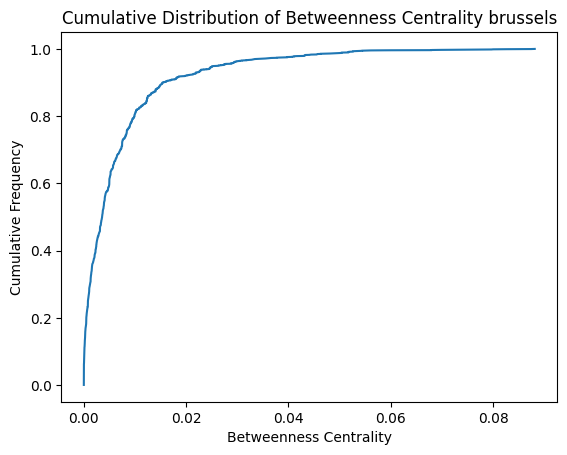

In [141]:
betweenness_centrality_df= pd.read_csv("./Betweeness_modularity_data/betwenness_centrality_brussels.csv")

betweenness_centrality_cumulative_distribution(betweenness_centrality_df,"brussels")

### betweenness centrality cumulative distribution Madrid

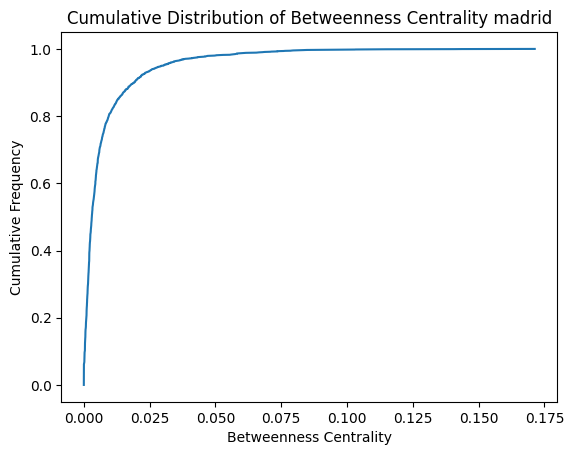

In [142]:
betweenness_centrality_df= pd.read_csv("./Betweeness_modularity_data/betwenness_centrality_madrid.csv")

betweenness_centrality_cumulative_distribution(betweenness_centrality_df,"madrid")

### Communities_visualization_brussels


Modularity:
0.9222194818266316


C:\Users\moham\AppData\Local\Temp\ipykernel_37044\171353078.py:70: UserWarning:

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.



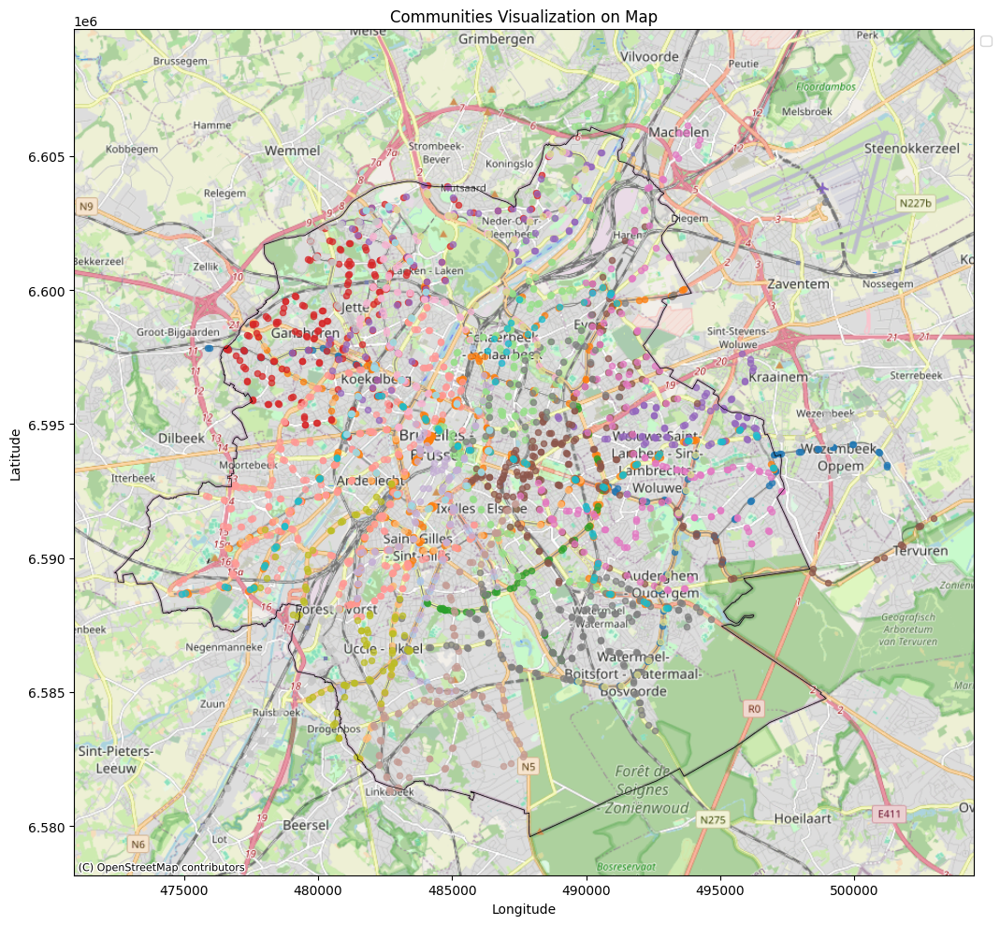

In [156]:
def Communities_visualization_brussels():
    from networkx.algorithms import community
    stops_df = pd.read_csv("./data/brussels/stops.txt")

    # Detect communities and calculate modularity
    adj_matrix_df = pd.read_csv("./Betweeness_modularity_data/adjacency_matrix_brussels.csv", index_col=0)

    # Convert adjacency matrix to a numpy array
    adj_matrix = adj_matrix_df.values

    # Create a directed graph from the adjacency matrix
    G = nx.from_numpy_array(adj_matrix, create_using=nx.DiGraph)
    
    # Relabel nodes with stop IDs for clarity (optional)
    mapping = {i: stop_id for i, stop_id in enumerate(adj_matrix_df.index)}
    G = nx.relabel_nodes(G, mapping)
    communities = community.greedy_modularity_communities(G, weight='weight')
    modularity = community.modularity(G, communities, weight='weight')
    print("\nModularity:")
    print(modularity)

    # Step 1: Map nodes to their communities
    node_to_community = {}
    for i, community in enumerate(communities):
        for node in community:
            node_to_community[node] = i

    # Step 2: Add community information to the stops DataFrame
    stops_df["community"] = stops_df["stop_id"].map(lambda x: node_to_community.get(x, -1))

    # Step 3: Convert stops_df to a GeoDataFrame
    stops_gdf = gpd.GeoDataFrame(
        stops_df,
        geometry=gpd.points_from_xy(stops_df.stop_lon, stops_df.stop_lat),
        crs="EPSG:4326"
    ).to_crs("EPSG:3857")

    # Step 4: Load shapefile for borders (optional)
    shapefile_path = "./Betweeness_modularity_data/Brussels_map/UrbAdm_REGION.shp"
    gdf = gpd.read_file(shapefile_path).to_crs("EPSG:3857")

    # Step 5: Assign colors to communities
    unique_communities = stops_gdf["community"].unique()
    community_colors = {
        community: plt.cm.tab20(i / len(unique_communities))
        for i, community in enumerate(unique_communities)
    }

    # Step 6: Plot the map
    plt.figure(figsize=(12, 10))

    # Plot shapefile boundaries
    gdf.boundary.plot(ax=plt.gca(), color="black", linewidth=0.5)

    # Plot stops, coloring by community
    for community, color in community_colors.items():
        community_stops = stops_gdf[stops_gdf["community"] == community]
        plt.scatter(
            community_stops.geometry.x,
            community_stops.geometry.y,
            color=color,
            s=20,
            alpha=0.7
        )

    # Add basemap
    ctx.add_basemap(plt.gca(), crs="EPSG:3857", source=ctx.providers.OpenStreetMap.Mapnik)

    # Add legend and labels
    plt.legend(loc="upper left", bbox_to_anchor=(1, 1))
    plt.title("Communities Visualization on Map")
    plt.xlabel("Longitude")
    plt.ylabel("Latitude")
    plt.tight_layout()
    plt.show()

Communities_visualization_brussels()

### Communities_visualization_madird


Modularity:
0.8972857958222825


C:\Users\moham\AppData\Local\Temp\ipykernel_37044\2205794530.py:64: UserWarning:

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.



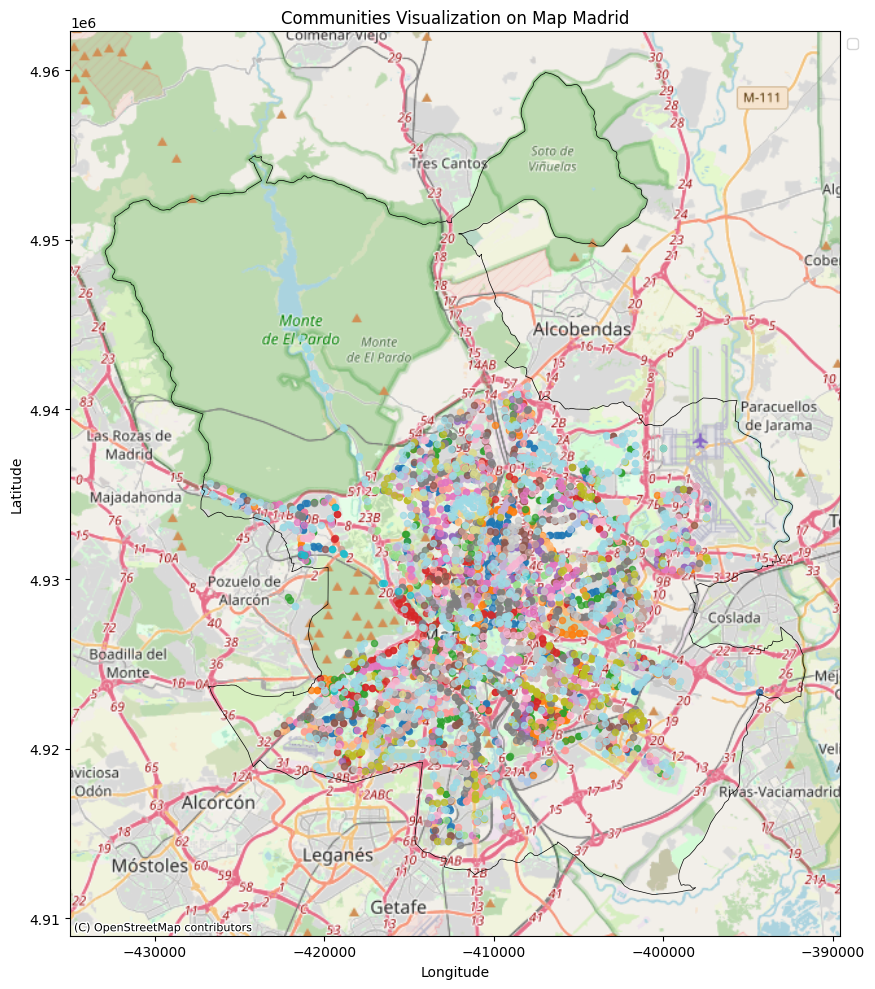

In [150]:
def Communities_visualization_madird():
    from networkx.algorithms import community

    # Detect communities and calculate modularity
    adj_matrix_df = pd.read_csv("./Betweeness_modularity_data/adjacency_matrix_madrid.csv", index_col=0)

    # Convert adjacency matrix to a numpy array
    adj_matrix = adj_matrix_df.values

    # Create a directed graph from the adjacency matrix
    G = nx.from_numpy_array(adj_matrix, create_using=nx.DiGraph)

    communities = community.greedy_modularity_communities(G, weight='weight')
    modularity = community.modularity(G, communities, weight='weight')
    print("\nModularity:")
    print(modularity)
    node_to_community = {}
    for i, community in enumerate(communities):
        for node in community:
            node_to_community[node] = i

    # Step 2: Add community information to the stops DataFrame
    stops_df["community"] = stops_df["stop_id"].map(lambda x: node_to_community.get(x, -1))

    # Step 3: Convert stops_df to a GeoDataFrame
    stops_gdf = gpd.GeoDataFrame(
        stops_df,
        geometry=gpd.points_from_xy(stops_df.stop_lon, stops_df.stop_lat),
        crs="EPSG:4326"
    ).to_crs("EPSG:3857")

    # Step 4: Load shapefile for borders (optional)
    shapefile_path = "./Betweeness_modularity_data/Madrid_map/Madrid_ETRS89.shp"
    gdf = gpd.read_file(shapefile_path).to_crs("EPSG:3857")

    # Step 5: Assign colors to communities
    unique_communities = stops_gdf["community"].unique()
    community_colors = {
        community: plt.cm.tab20(i / len(unique_communities))
        for i, community in enumerate(unique_communities)
    }

    # Step 6: Plot the map
    plt.figure(figsize=(12, 10))

    # Plot shapefile boundaries
    gdf.boundary.plot(ax=plt.gca(), color="black", linewidth=0.5)

    # Plot stops, coloring by community
    for community, color in community_colors.items():
        community_stops = stops_gdf[stops_gdf["community"] == community]
        plt.scatter(
            community_stops.geometry.x,
            community_stops.geometry.y,
            color=color,
            s=20,
            alpha=0.7
        )

    # Add basemap
    ctx.add_basemap(plt.gca(), crs="EPSG:3857", source=ctx.providers.OpenStreetMap.Mapnik)

    # Add legend and labels
    plt.legend(loc="upper left", bbox_to_anchor=(1, 1))
    plt.title("Communities Visualization on Map Madrid")
    plt.xlabel("Longitude")
    plt.ylabel("Latitude")
    plt.tight_layout()
    plt.show()
Communities_visualization_madird()

## Eigenvector Centrality

In [246]:
import os


def process_city_with_static_map(city_name,shapefile_path_file):
    city_path = os.path.join("./data/", city_name)
    stops_df = pd.read_csv(os.path.join(city_path, "stops.txt"))
    stop_times_df = pd.read_csv(os.path.join(city_path, "stop_times.txt"))
    trips_df = pd.read_csv(os.path.join(city_path, "trips.txt"))

    # merge stop_times with stops to get stop details
    stop_times_with_stops = stop_times_df.merge(stops_df, on="stop_id")
    G = nx.DiGraph()

    # add nodes (stops)
    for _, stop in stops_df.iterrows():
        G.add_node(
            stop["stop_id"],
            name=stop["stop_name"],
            lat=stop["stop_lat"],
            lon=stop["stop_lon"],
        )

    # add edges (connections based on stop sequence)
    for trip_id, trip_data in stop_times_with_stops.groupby("trip_id"):
        trip_data = trip_data.sort_values("stop_sequence")
        for i in range(len(trip_data) - 1):
            stop_a = trip_data.iloc[i]
            stop_b = trip_data.iloc[i + 1]
            G.add_edge(
                stop_a["stop_id"],
                stop_b["stop_id"],
                trip_id=trip_id,
            )

    # extract the largest strongly connected component
    largest_scc = max(nx.strongly_connected_components(G), key=len)
    subgraph = G.subgraph(largest_scc)

    # calculate eigenvector centrality
    eigenvector_centrality = nx.eigenvector_centrality_numpy(subgraph, weight=None)

    eigenvector_centrality_df = pd.DataFrame(
        eigenvector_centrality.items(), columns=["stop_id", "eigenvector_centrality"]
    )
    stops_with_centrality = stops_df.merge(eigenvector_centrality_df, on="stop_id", how="inner")

    print(f"Centrality values for {city_name.capitalize()}:")
    print(stops_with_centrality[["stop_id", "stop_name", "eigenvector_centrality"]])
    print("\n")

    # transform stops data to EPSG:3857
    transformer = Transformer.from_crs("EPSG:4326", "EPSG:3857", always_xy=True)
    stops_with_centrality["stop_lon"], stops_with_centrality["stop_lat"] = transformer.transform(
        stops_with_centrality["stop_lon"].values,
        stops_with_centrality["stop_lat"].values,
    )

    stops_with_centrality = stops_with_centrality.dropna(
        subset=["stop_lon", "stop_lat", "eigenvector_centrality"]
    )

    shapefile_path = f"./{shapefile_path_file}"
    gdf = gpd.read_file(shapefile_path).to_crs("EPSG:3857")

    plt.figure(figsize=(10, 8))
    scatter = plt.scatter(
        stops_with_centrality["stop_lon"],
        stops_with_centrality["stop_lat"],
        c=stops_with_centrality["eigenvector_centrality"],
        s=50 + 5000 * stops_with_centrality["eigenvector_centrality"],  
        cmap="viridis",
        alpha=0.3,
        edgecolor="k",
    )

    gdf.boundary.plot(ax=plt.gca(), color="black")  
    plt.colorbar(scatter, label="Eigenvector Centrality")
    plt.xlabel("Longitude")
    plt.ylabel("Latitude")
    plt.title(f"{city_name.capitalize()} Eigenvector Centrality")
    ctx.add_basemap(plt.gca(), crs="EPSG:3857", source=ctx.providers.OpenStreetMap.Mapnik)
    svg_path = os.path.join(city_path, f"{city_name}_eigen_map.png")
    plt.savefig(svg_path, format="png", bbox_inches="tight")
    plt.tight_layout()
    plt.show()

    return stops_with_centrality



### Eigenvector Centrality Brussels

Centrality values for Brussels:
     stop_id         stop_name  eigenvector_centrality
0       1000     GARE CENTRALE            3.763525e-01
1       1001     GARE CENTRALE            1.886489e-01
2       1003     GARE CENTRALE            1.387563e-01
3       1005     GARE CENTRALE            1.305721e-01
4       1006             POGGE            6.914302e-04
...      ...               ...                     ...
1583    9786       HELDENPLEIN            3.656476e-07
1584    9787    KERK VILVOORDE            2.130421e-07
1585    9851      LENNEKE MARE            1.033055e-06
1586    9853  HOF TER MUSSCHEN            5.427273e-06
1587    9876      LENNEKE MARE            7.778610e-05

[1588 rows x 3 columns]




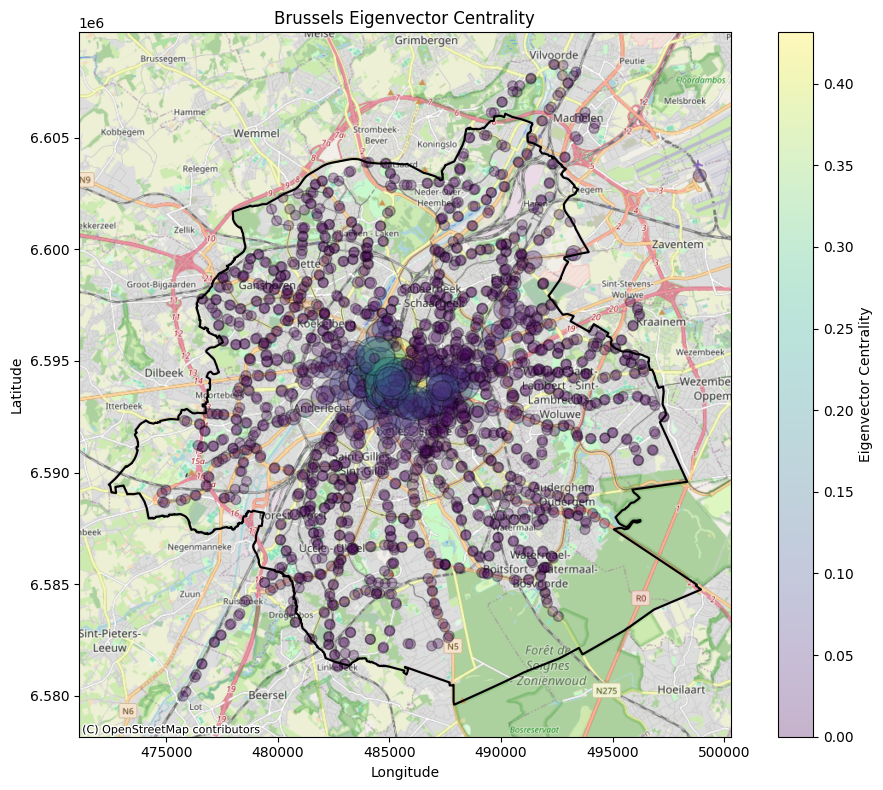

,stop_id,stop_code,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_type,parent_station,eigenvector_centrality
0,1000,NaN,GARE CENTRALE,NaN,6.593939e+06,485310.344494,NaN,NaN,0,NaN,3.763525e-01
1,1001,NaN,GARE CENTRALE,NaN,6.593846e+06,485010.783744,NaN,NaN,0,NaN,1.886489e-01
2,1003,NaN,GARE CENTRALE,NaN,6.593862e+06,485310.121855,NaN,NaN,0,NaN,1.387563e-01
3,1005,NaN,GARE CENTRALE,NaN,6.594245e+06,484977.387897,NaN,NaN,0,NaN,1.305721e-01
4,1006,NaN,POGGE,NaN,6.597732e+06,487066.298141,NaN,NaN,0,NaN,6.914302e-04
...,...,...,...,...,...,...,...,...,...,...,...
1583,9786,NaN,HELDENPLEIN,NaN,6.608247e+06,492785.225661,NaN,NaN,0,NaN,3.656476e-07
1584,9787,NaN,KERK VILVOORDE,NaN,6.608293e+06,492356.756941,NaN,NaN,0,NaN,2.130421e-07
1585,9851,NaN,LENNEKE MARE,NaN,6.595927e+06,495386.650842,NaN,NaN,0,NaN,1.033055e-06
1586,9853,NaN,HOF TER MUSSCHEN,NaN,6.595588e+06,495121.933093,NaN,NaN,0,NaN,5.427273e-06


In [ ]:
process_city_with_static_map("brussels","Betweeness_modularity_data/Brussels_map/UrbAdm_REGION.shp")

### Eigenvector Centrality Madrid

Centrality values for Madrid:
      stop_id                                   stop_name  \
0           1     Avenida Valdemarín - Blanca De Castilla   
1           2               Avenida Valdemarín - La Salle   
2           3  Blanca De Castilla - Camino De La Zarzuela   
3           4                       Pléyades - Ana Teresa   
4           5                        Pléyades - Osa Mayor   
...       ...                                         ...   
4859    51111          Vicente Camarón - Huerta Castañeda   
4860    51112      Vicente Camarón - Av. De Los Apóstoles   
4861    51113  Vicente Camarón - Costanilla De Los Olivos   
4862    51114            Paseo Jesuitas - Salvador Crespo   
4863    51116               Navalperal - López Puigcerver   

      eigenvector_centrality  
0                   0.000024  
1                   0.000014  
2                   0.000004  
3                   0.000003  
4                   0.000001  
...                      ...  
4859                

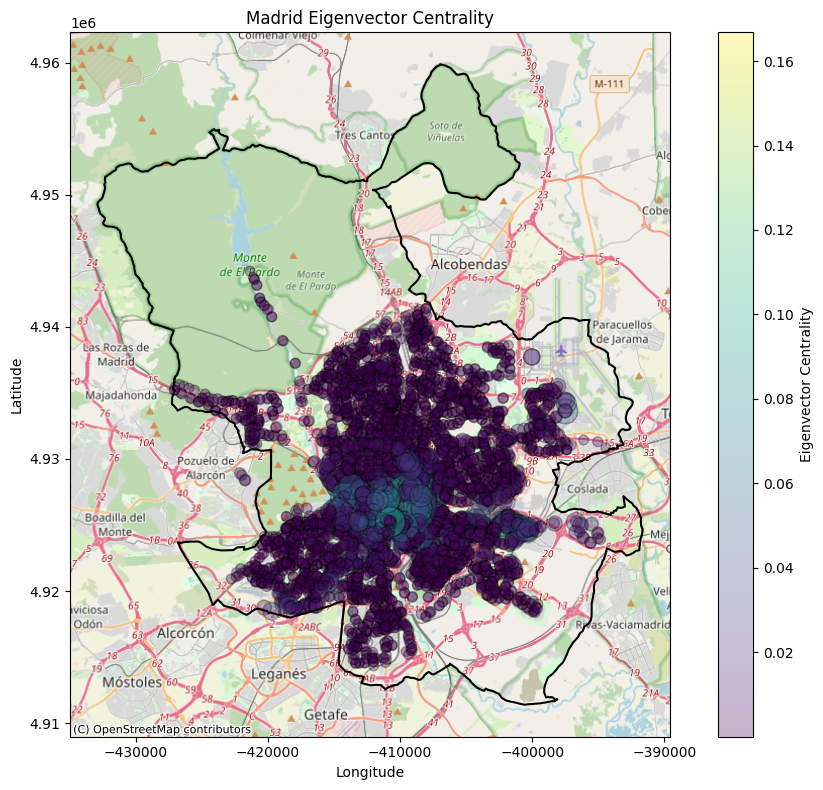

,stop_id,stop_code,stop_name,stop_desc,stop_lat,stop_lon,zone_id,stop_url,location_type,parent_station,eigenvector_centrality
0,1,1,Avenida Valdemarín - Blanca De Castilla,NaN,4.934493e+06,-421108.275332,NaN,http://www.emtmadrid.es/aplicaciones/Estimacio...,NaN,NaN,0.000024
1,2,2,Avenida Valdemarín - La Salle,NaN,4.934276e+06,-421451.139364,NaN,http://www.emtmadrid.es/aplicaciones/Estimacio...,NaN,NaN,0.000014
2,3,3,Blanca De Castilla - Camino De La Zarzuela,NaN,4.933734e+06,-421216.255238,NaN,http://www.emtmadrid.es/aplicaciones/Estimacio...,NaN,NaN,0.000004
3,4,4,Pléyades - Ana Teresa,NaN,4.933218e+06,-421244.085111,NaN,http://www.emtmadrid.es/aplicaciones/Estimacio...,NaN,NaN,0.000003
4,5,5,Pléyades - Osa Mayor,NaN,4.932926e+06,-421265.235814,NaN,http://www.emtmadrid.es/aplicaciones/Estimacio...,NaN,NaN,0.000001
...,...,...,...,...,...,...,...,...,...,...,...
4859,51111,51111,Vicente Camarón - Huerta Castañeda,NaN,4.925150e+06,-416515.233142,NaN,http://www.emtmadrid.es/aplicaciones/Estimacio...,NaN,NaN,0.000173
4860,51112,51112,Vicente Camarón - Av. De Los Apóstoles,NaN,4.925138e+06,-416323.763618,NaN,http://www.emtmadrid.es/aplicaciones/Estimacio...,NaN,NaN,0.000099
4861,51113,51113,Vicente Camarón - Costanilla De Los Olivos,NaN,4.925119e+06,-416072.181569,NaN,http://www.emtmadrid.es/aplicaciones/Estimacio...,NaN,NaN,0.000057
4862,51114,51114,Paseo Jesuitas - Salvador Crespo,NaN,4.925109e+06,-415858.448146,NaN,http://www.emtmadrid.es/aplicaciones/Estimacio...,NaN,NaN,0.001497


In [248]:
process_city_with_static_map("madrid","Betweeness_modularity_data/Madrid_map/Madrid_ETRS89.shp")

## Closeness Centrality

In [ ]:
from scipy.stats import gaussian_kde

class GTFSAnalysis:
    def __init__(self, city_name, data_folder, shapefile_path):
        self.city_name = city_name
        self.data_folder = data_folder
        self.shapefile_path = shapefile_path
        self.stops_df = None
        self.stop_times_df = None
        self.trips_df = None
        self.calendar_df = None
        self.graph = None
        self.closeness_centrality = None

    def load_data(self):
        self.stops_df = pd.read_csv(os.path.join(self.data_folder, "stops.txt"))
        self.stop_times_df = pd.read_csv(os.path.join(self.data_folder, "stop_times.txt"))
        self.trips_df = pd.read_csv(os.path.join(self.data_folder, "trips.txt"))
        self.calendar_df = pd.read_csv(os.path.join(self.data_folder, "calendar.txt"))

    def preprocess_graph(self):
        trips_with_calendar = pd.merge(self.trips_df, self.calendar_df, on="service_id")
        trips_with_calendar["weekly_trips"] = trips_with_calendar[
            ["monday", "tuesday", "wednesday", "thursday", "friday", "saturday", "sunday"]
        ].sum(axis=1)

        stop_times_with_trips = pd.merge(self.stop_times_df, trips_with_calendar[["trip_id", "weekly_trips"]], on="trip_id")

        edges = []
        for trip_id, group in stop_times_with_trips.groupby("trip_id"):
            stops_sequence = group.sort_values("stop_sequence")
            for i in range(len(stops_sequence) - 1):
                source = stops_sequence.iloc[i]["stop_id"]
                target = stops_sequence.iloc[i + 1]["stop_id"]
                weight = stops_sequence.iloc[i]["weekly_trips"]
                edges.append((source, target, weight))

        self.graph = nx.DiGraph()
        self.graph.add_nodes_from(self.stops_df["stop_id"].tolist())
        self.graph.add_weighted_edges_from(edges)

    def compute_closeness_centrality(self):
        self.closeness_centrality = nx.closeness_centrality(self.graph, distance="weight")

    def analyze_centrality(self):
        stop_id_to_name = self.stops_df.set_index("stop_id")["stop_name"].to_dict()
        sorted_centrality = sorted(self.closeness_centrality.items(), key=lambda x: x[1], reverse=True)

        top_3_nodes = sorted_centrality[:3]
        bottom_3_nodes = sorted_centrality[-3:]
        centrality_values = list(self.closeness_centrality.values())

        print(f"\n--- {self.city_name.capitalize()} Closeness Centrality Analysis ---")
        for i, (node, centrality) in enumerate(top_3_nodes):
            print(f"Top {i+1}: {stop_id_to_name.get(node, 'Unknown Stop')} (ID: {node}) with centrality {centrality:.4f}")

        for i, (node, centrality) in enumerate(bottom_3_nodes):
            print(f"Bottom {i+1}: {stop_id_to_name.get(node, 'Unknown Stop')} (ID: {node}) with centrality {centrality:.4f}")

        print(f"\nMean Centrality: {np.mean(centrality_values):.4f}")
        print(f"Median Centrality: {np.median(centrality_values):.4f}")
        print(f"Standard Deviation: {np.std(centrality_values):.4f}")

    def plot_closeness_centrality_map(self):
        closeness_centrality_df = pd.DataFrame(
            list(self.closeness_centrality.items()), columns=["stop_id", "closeness_centrality"]
        )
        stops_with_centrality = self.stops_df.merge(closeness_centrality_df, on="stop_id")

        transformer = Transformer.from_crs("EPSG:4326", "EPSG:3857", always_xy=True)
        stops_with_centrality["stop_lon"], stops_with_centrality["stop_lat"] = transformer.transform(
            stops_with_centrality["stop_lon"].values,
            stops_with_centrality["stop_lat"].values,
        )

        stops_with_centrality = stops_with_centrality.dropna(subset=["stop_lon", "stop_lat", "closeness_centrality"])
        gdf = gpd.read_file(self.shapefile_path).to_crs("EPSG:3857")

        plt.figure(figsize=(12, 10))
        scatter = plt.scatter(
            stops_with_centrality["stop_lon"],
            stops_with_centrality["stop_lat"],
            c=stops_with_centrality["closeness_centrality"],
            s=30 + 5000 * stops_with_centrality["closeness_centrality"],
            cmap="plasma",
            alpha=0.5,
            edgecolor="k",
        )
        gdf.boundary.plot(ax=plt.gca(), color="black")
        plt.colorbar(scatter, label="Closeness Centrality")
        plt.title(f"{self.city_name.capitalize()} Closeness Centrality Map")
        ctx.add_basemap(plt.gca(), crs="EPSG:3857", source=ctx.providers.OpenStreetMap.Mapnik)
        plt.tight_layout()
        plt.savefig(f"{self.city_name}_closeness_map.png")
        plt.show()

    def plot_density_heatmap(self):
        transformer = Transformer.from_crs("EPSG:4326", "EPSG:3857", always_xy=True)
        self.stops_df["stop_lon"], self.stops_df["stop_lat"] = transformer.transform(
            self.stops_df["stop_lon"].values, self.stops_df["stop_lat"].values,
        )
        gdf = gpd.read_file(self.shapefile_path).to_crs("EPSG:3857")

        x = self.stops_df["stop_lon"].values
        y = self.stops_df["stop_lat"].values
        xy = np.vstack([x, y])
        kde = gaussian_kde(xy)
        z = kde(xy)

        plt.figure(figsize=(12, 10))
        scatter = plt.scatter(x, y, c=z, cmap="viridis", s=30, alpha=0.6, edgecolor=None)
        gdf.boundary.plot(ax=plt.gca(), color="black")
        ctx.add_basemap(plt.gca(), crs="EPSG:3857", source=ctx.providers.OpenStreetMap.Mapnik)
        plt.colorbar(scatter, label="Density")
        plt.title(f"{self.city_name.capitalize()} Stop Density Heatmap")
        plt.tight_layout()
        plt.savefig(f"{self.city_name}_density_heatmap.png")
        plt.show()


### Closeness Centrality Brussels


--- Brussels Closeness Centrality Analysis ---
Top 1: BOTANIQUE (ID: 6435) with centrality 0.0144
Top 2: RUE TRAVERSIERE (ID: 9023B) with centrality 0.0141
Top 3: GILLON (ID: 6359) with centrality 0.0141
Bottom 1: VANDERVELDE (ID: 18) with centrality 0.0000
Bottom 2: VEEWEYDE (ID: 27) with centrality 0.0000
Bottom 3: YSER (ID: 51) with centrality 0.0000

Mean Centrality: 0.0053
Median Centrality: 0.0063
Standard Deviation: 0.0043


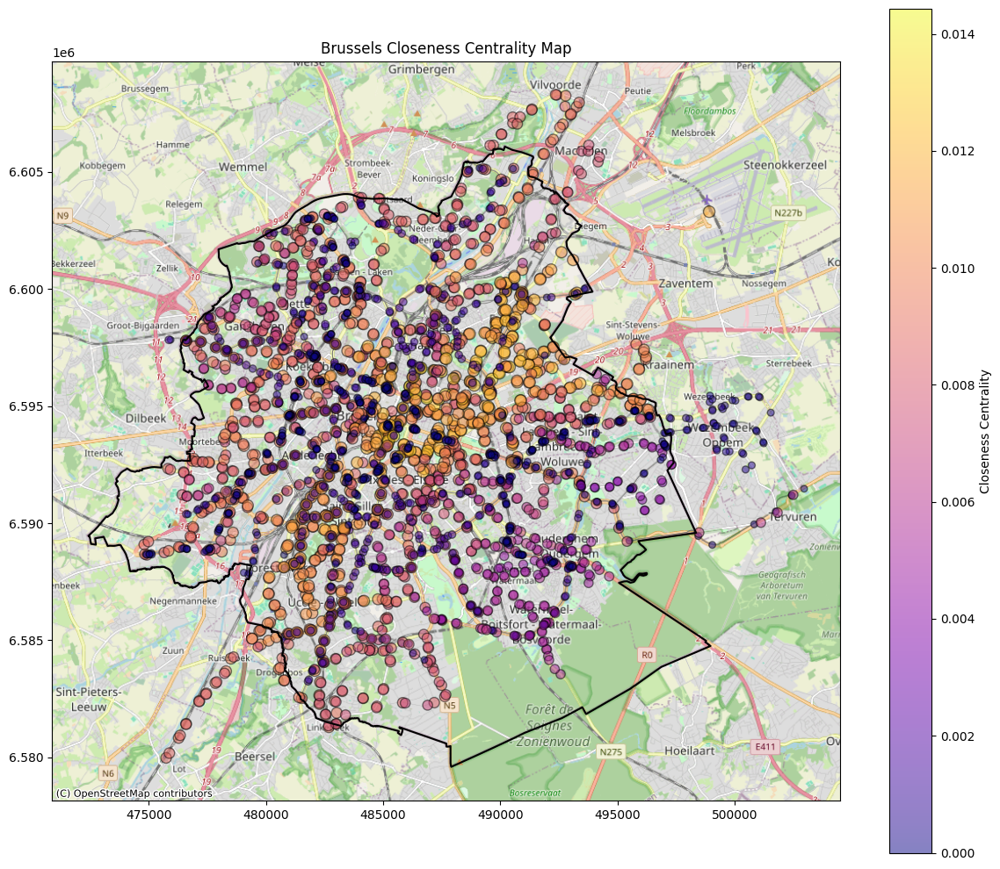

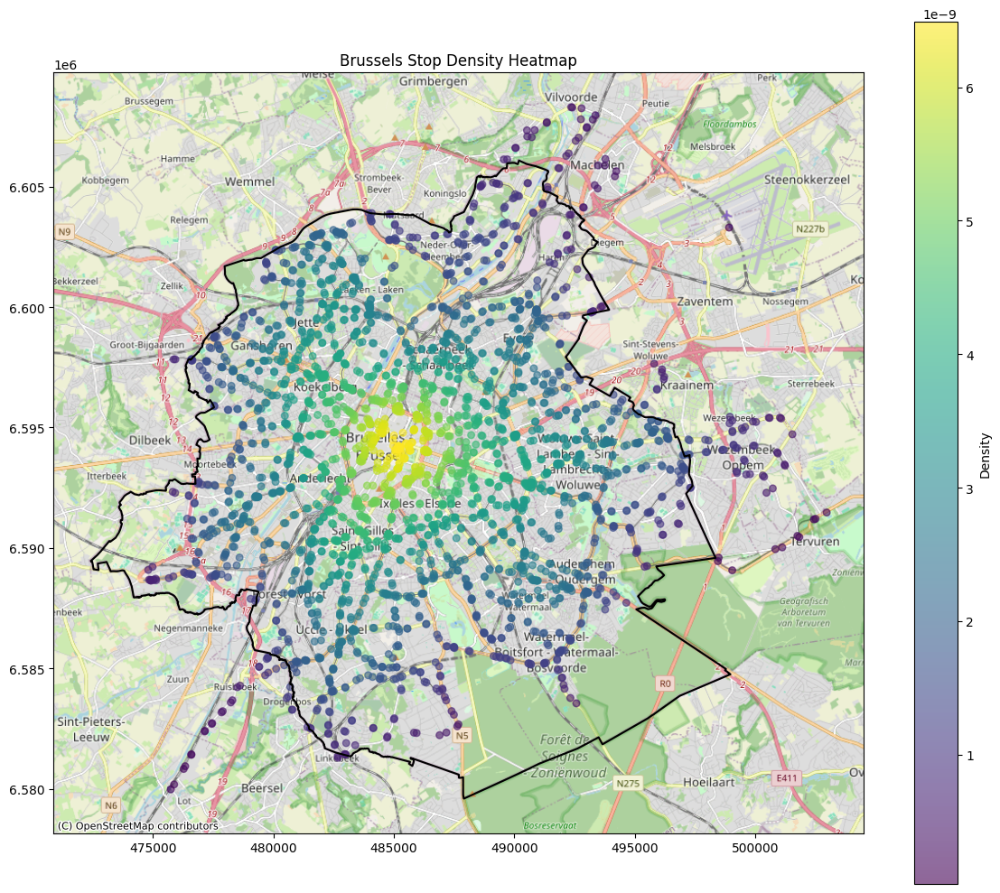

In [256]:
# Example Usage
brussels_analysis = GTFSAnalysis(
    city_name="brussels",
    data_folder="./data/brussels",
    shapefile_path="./Betweeness_modularity_data/Brussels_map/UrbAdm_REGION.shp",
)
brussels_analysis.load_data()
brussels_analysis.preprocess_graph()
brussels_analysis.compute_closeness_centrality()
brussels_analysis.analyze_centrality()
brussels_analysis.plot_closeness_centrality_map()
brussels_analysis.plot_density_heatmap()

### Closeness Centrality Madrid


--- Madrid Closeness Centrality Analysis ---
Top 1: Cibeles (ID: 69) with centrality 0.0516
Top 2: Neptuno (ID: 77) with centrality 0.0497
Top 3: Estación De Atocha (ID: 5709) with centrality 0.0496
Bottom 1: Rivas - Boyer (ID: 4015) with centrality 0.0001
Bottom 2: Rivas - Gran Vía Del Este (ID: 4013) with centrality 0.0001
Bottom 3: Pirotecnia - Pedro Escarbassiere (ID: 4051) with centrality 0.0001

Mean Centrality: 0.0320
Median Centrality: 0.0318
Standard Deviation: 0.0061


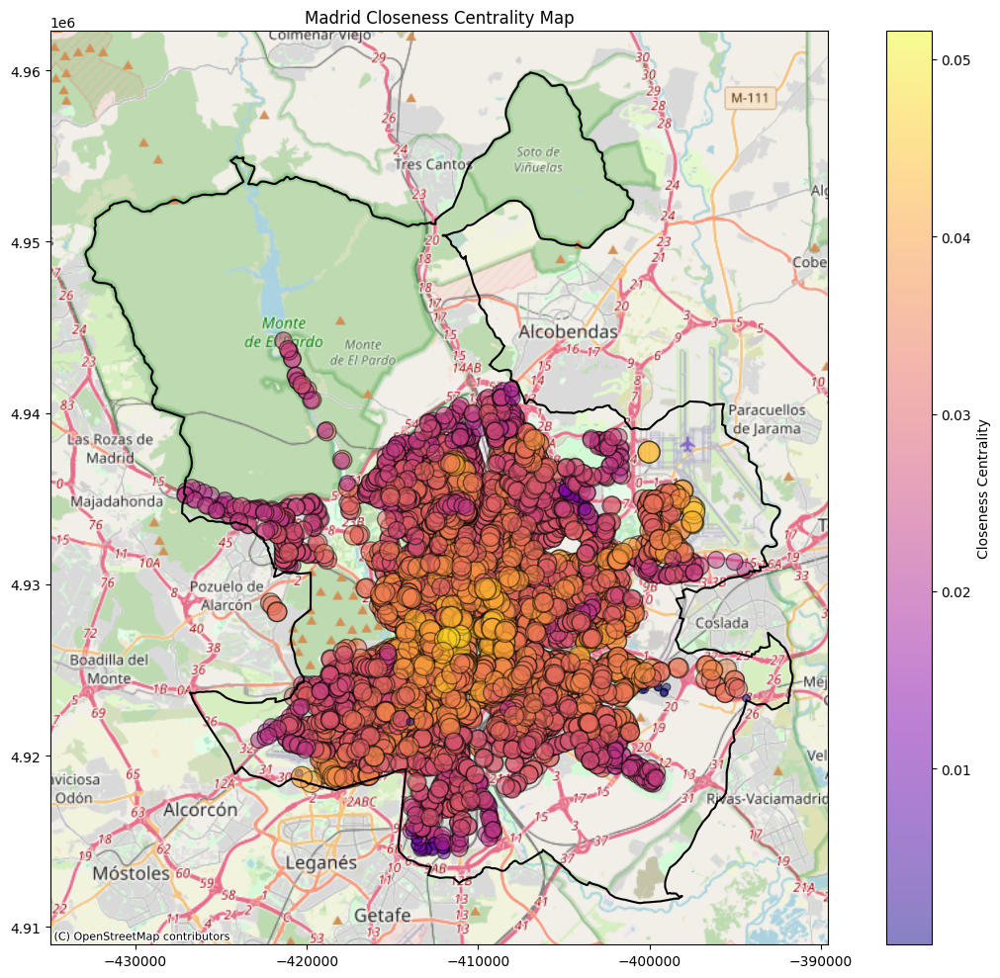

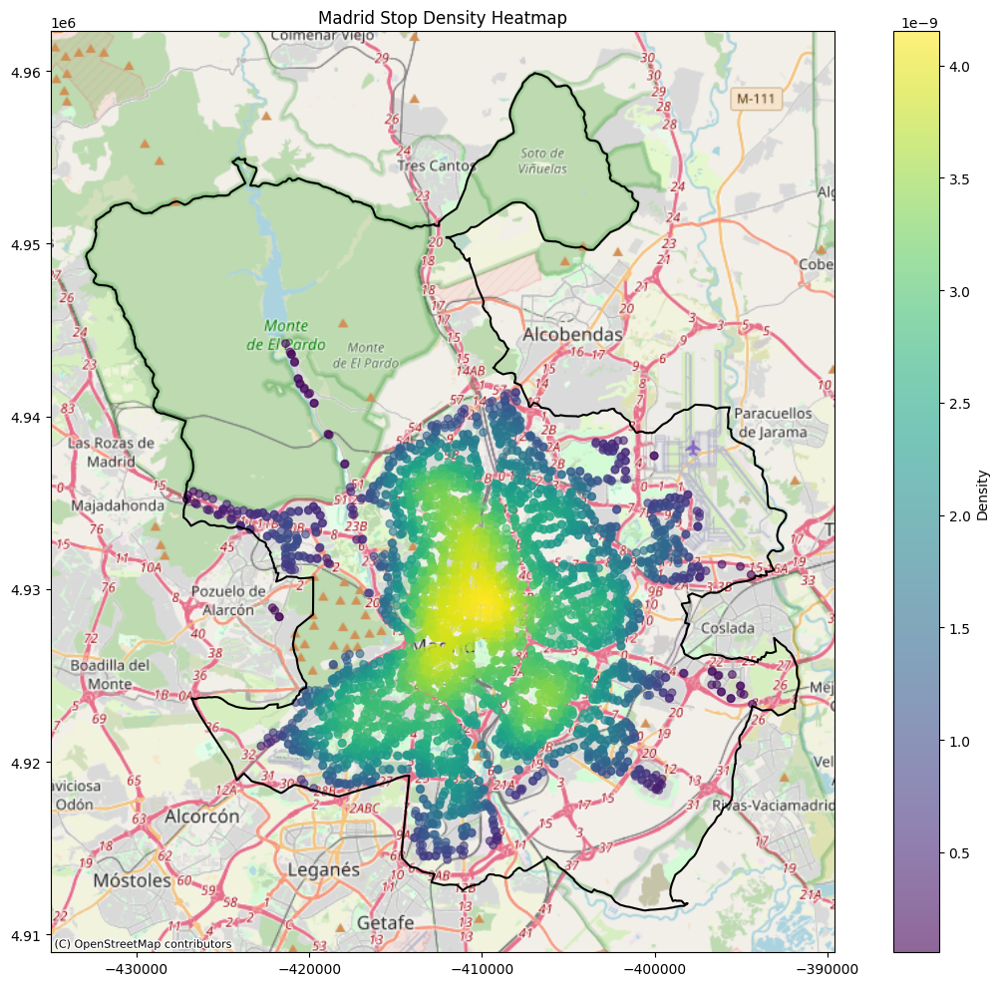

In [258]:
madrid_analysis = GTFSAnalysis(
    city_name="madrid",
    data_folder="./data/madrid",
    shapefile_path="./Betweeness_modularity_data/Madrid_map/Madrid_ETRS89.shp",
)
madrid_analysis.load_data()
madrid_analysis.preprocess_graph()
madrid_analysis.compute_closeness_centrality()
madrid_analysis.analyze_centrality()
madrid_analysis.plot_closeness_centrality_map()
madrid_analysis.plot_density_heatmap()